In [1]:
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import style
style.use('seaborn-whitegrid')

device = "cuda" if torch.cuda.is_available() else "cpu"

In [2]:
class MultiRBFnn(nn.Module):
    def __init__(self, in_feature, add_rbf_num, device):
        super(MultiRBFnn, self).__init__()

        self.add_rbf_num = add_rbf_num  # additional RBFs number
        self.in_feature = in_feature    # count features
        self.device = device
        self.centers_list = []
        self.sigmas_list = []
        self.weights_list = []

        self.change_th = 3

    def first_rbf_parameter(self, input_data, target): # done

        # input_data shape : (data_num)
        # target data shape : (in_feature, data_num)
        
        # first layer centers, weights, sigmas
        # centers, sigmas : (add_rbf_num, 1)
        # weights : (in_feature, add_rbf_num)

        find_index_input = input_data.clone().detach()
        fine_index_target = target.clone().detach()

        find_sigma = target.clone().detach()
        find_weight = target.clone().detach()
        center_index_list = []

        # first MultiRBFs initial centers and weights parameters
        for i in range(self.add_rbf_num):
            index_ = torch.argmax(torch.sum(torch.abs(fine_index_target), dim = 0)).cpu().detach().tolist()
            fine_index_target[:,index_] = 0
            center_index_list.append(index_)

        center_index_list = torch.tensor(center_index_list, device= self.device)
        initcenter = torch.index_select(find_index_input, 0, center_index_list)[-self.add_rbf_num:].reshape(self.add_rbf_num,1)
        initweight = torch.index_select(find_weight, 1, center_index_list)[-self.add_rbf_num:].reshape(self.in_feature, self.add_rbf_num)

        # first MultiRBFs initial sigmas parameters                
        sigma_list = []
        dft = torch.log(torch.abs(torch.fft.fft(find_sigma).real))
        dft =  torch.abs(dft / torch.max(dft)) **-1
        for k in center_index_list:
            sigma_list.append(torch.mean(dft[:,k]).reshape(1))

        initsigma = torch.cat(sigma_list)[-self.add_rbf_num:].reshape(self.add_rbf_num, 1)

        # print(initcenter, initweight, initsigma)
        return initcenter, initweight, initsigma
    
    def add_rbf_parameter(self, input_data, error):
        find_index_input = input_data.clone().detach()
        find_index_error = error.clone().detach()
        
        find_weight = error.clone().detach()
        find_sigma = error.clone().detach()
        
        center_index_list = []

        for i in range(self.add_rbf_num * (self.change_time + 1)):
            index_ = torch.argmax(torch.sum(torch.abs(find_index_error), dim = 0)).cpu().detach().tolist()

            find_index_error[:,index_] = 0
            center_index_list.append(index_)

        center_index_list = torch.tensor(center_index_list, device=self.device)
        initcenter = torch.index_select(find_index_input, 0, center_index_list)[-self.add_rbf_num:].reshape(self.add_rbf_num,1)
        initweight = torch.index_select(find_weight, 1, center_index_list)[::,-self.add_rbf_num:].reshape(self.in_feature, self.add_rbf_num)


        sigma_list = []
        dft = torch.log(torch.abs(torch.fft.fft(find_sigma).real))
        
        dft = (torch.abs(dft / torch.max(dft))**-1)
        for k in center_index_list:
            sigma_list.append(torch.mean(dft[:,k]).reshape(1))
        initsigma = torch.cat(sigma_list)[-self.add_rbf_num:].reshape(self.add_rbf_num,1)
        #print(initcenter, initweight, initsigma)
        return initcenter, initweight, initsigma
    
    
    def rbf_gaussian(self, input_data):
        out = torch.exp(-1 *(torch.pow((input_data - self.centers), 2)) / (torch.pow(self.sigma, 2)))

        return out

    def forward(self, input_data):
        R = self.rbf_gaussian(input_data)
        pred = torch.mm(self.weights, R)

        return R, pred

    def rbf_gaussian_derivative_centers(self, input_data): # done
        output = (2 * (input_data - self.centers) / (torch.pow(self.sigma, 2))) * self.rbf_gaussian(input_data)

        return output  # size = (add_rbf_num, data_num)

    def rbf_gaussian_derivative_sigma(self, input_data): # done
        output = (2 * torch.pow((input_data - self.centers), 2) / (torch.pow(self.sigma, 3))) * self.rbf_gaussian(input_data)

        return output  # size = (add_rbf_num, data_num)
    
    # FUNCTION GRADIENT
    def rbf_gradient(self, input_data, centers, sigmas, weights):
        rbf_output = (-2 * (input_data-centers) / torch.pow(sigmas,2)) * \
                        (torch.exp(-1 * (torch.pow((input_data - centers), 2) / (torch.pow(sigmas, 2)))))
        rbf_grad = torch.mm(weights, rbf_output)
        
        return rbf_grad
    
    def first_grad(self, input_data, target):
        space = (input_data,)
        f_grad = torch.gradient(target[0], spacing = space, edge_order  = 1)
        return f_grad[0]
    
    def target_grad(self, input_data, centers, sigmas, weights, f_grad):
        true_grad = f_grad - self.rbf_gradient(input_data, centers, sigmas, weights)
        
        return true_grad
    
    def rbf_gaussian_derivative_centers(self, input_data):
        output = (2 * (input_data - self.centers) / \
                  (torch.pow(self.sigma, 2))) * self.rbf_gaussian(input_data)

        return output  # size = (num_radial, 1)
    
    def rbf_gaussian_derivative_sigma(self, input_data):
        output = (2 * torch.pow((input_data - self.centers), 2) / \
                (torch.pow(self.sigma, 3))) * self.rbf_gaussian(input_data)

        return output  # size = (num_radial, 1)

    def L2_F(self, input_data):
        return -2 * (input_data - self.centers) / torch.pow(self.sigma, 2)
    
    def L2_2_derivateive_weight(self, input_data, radial_output):
        return (-2 *(input_data - self.centers) / torch.pow(self.sigma,2)) * radial_output


    # Backpropagation and train

    def BP(self, input_data, target, R, pred, target_grad, pred_grad):
        L2_1_error = -2 * (target - pred)

        L2_2_error = -2 * (target_grad - pred_grad)


        # sigma update
        deltaSigma1 = self.rbf_gaussian_derivative_sigma(input_data) * L2_1_error.reshape(self.in_feature, 1, input_data.size(0))
        deltaSigma1 *= self.weights.reshape(self.in_feature, self.add_rbf_num, 1)

        deltaSigma2 = self.rbf_gaussian_derivative_sigma(input_data) * L2_2_error.reshape(self.in_feature, 1, input_data.size(0))
        deltaSigma2 *= self.L2_F(input_data) * self.weights.reshape(self.in_feature, self.add_rbf_num, 1)

        deltaSigma =  torch.mean(torch.sum(deltaSigma1, dim=2), dim = 0) + torch.mean(torch.sum(deltaSigma2, dim=2), dim = 0)

        # center update
        deltaCenter1 = self.rbf_gaussian_derivative_centers(input_data) * L2_1_error.reshape(self.in_feature, 1, input_data.size(0))
        deltaCenter1 *= self.weights.reshape(self.in_feature, self.add_rbf_num, 1)

        deltaCenter2 = self.rbf_gaussian_derivative_centers(input_data) * L2_2_error.reshape(self.in_feature, 1, input_data.size(0))
        deltaCenter2 *= self.L2_F(input_data) * self.weights.reshape(self.in_feature, self.add_rbf_num, 1)
        deltaCenter =  torch.mean(torch.sum(deltaCenter1, dim=2), dim = 0) + torch.mean(torch.sum(deltaCenter2, dim=2), dim = 0)

        
        # weight update
        delta_weight1 = torch.sum((R * L2_1_error.reshape(self.in_feature, 1, input_data.size(0))), dim=2)
        delta_weight2 = torch.sum(self.L2_2_derivateive_weight(input_, R) * L2_2_error.reshape(self.in_feature, 1, input_data.size(0)), dim = 2)
        delta_weight = delta_weight1 + delta_weight2
        
        # BP update
        self.weights -= self.lr * delta_weight
        #self.centers -= self.lr * torch.sum(deltaCenter1, dim=1).reshape(self.add_rbf_num, 1)
        #self.sigma -= self.lr * torch.sum(deltaSigma1, dim=1).reshape(self.add_rbf_num, 1)
        self.centers -= self.lr * deltaCenter.reshape(self.add_rbf_num, 1)
        self.sigma -= self.lr * deltaSigma.reshape(self.add_rbf_num, 1)

    def change_init(self, na):
        if na == 1:
            loss_list = self.train_loss_list[-self.change_th:]
            if self.number > self.change_th and max(loss_list) == min(loss_list):
                self.change_time += 1
            elif self.number > self.change_th and loss_list[0] < loss_list[1] and loss_list[1] < loss_list[2]:
                self.change_time += 1
            else:
                self.change_time = 0
        else:
            self.change_time += 1
    
    def plot_train(self, input_data, best_pred): #done
        if self.in_feature != 1:
            fig, ax = plt.subplots(1, self.in_feature, figsize = (30, 5))
            for i in range(self.in_feature):
                ax[i].plot(input_data.cpu().detach().numpy(), self.target[i].cpu().detach().numpy())
                ax[i].plot(input_data.cpu().detach().numpy(), best_pred[i].cpu().detach().numpy())
            plt.show()
        
        else:
            plt.plot(input_data.cpu().detach().numpy(), self.target[0].cpu().detach().numpy())
            plt.plot(input_data.cpu().detach().numpy(), best_pred[0].cpu().detach().numpy())
            plt.show()

    def best_forward(self, input_data, best_center, best_sigma, best_weight): # ?
        rbf_output = torch.exp(-1 * (torch.pow((input_data - best_center), 2) / \
                                        (torch.pow(best_sigma, 2))))
        pred = torch.mm(best_weight, rbf_output)

        return pred
    
    def Loss(self, pred, target, pred_grad, true_grad):
        # value L2 loss  

        return torch.mean(torch.pow(target - pred,2) + torch.pow(true_grad - pred_grad, 2)) 
    
    def pred(self, input_data):
        rbf_output = torch.exp(-1 * (torch.pow((input_data - self.done_centers), 2) / \
                                     (torch.pow(self.done_sigma, 2))))
        pred = torch.mm(self.done_weights, rbf_output)

        return rbf_output, pred
        
    def train(self, input_data, target, epochs, lr, loss_th, lr_change_th):
        self.lr = lr
        self.target = target.clone().detach()
        self.number = 0
        self.train_loss_list = []
        self.loss_th = loss_th
        self.lr_change_th = lr_change_th
        self.target_mape_th = torch.mean(torch.abs(target)) * 0.05
        self.round_number = 5
        self.change_time = 0
        count_loss_chage = 0
        count_round_change = 0

        break_time = len(input_data) / self.add_rbf_num

        loss = 100000
        
        while self.loss_th < loss:

            print("{}th additional rbflayer".format(self.number))
            # first rbflayer
            if self.number == 0:
                self.centers, self.weights, self.sigma = self.first_rbf_parameter(input_data, self.target)
                first_grad = self.first_grad(input_data, target)
                for epoch in range(epochs):
                    # print("epoch : {}".format(epoch))
                    R, pred = self.forward(input_data)
                    rbf_grad = self.rbf_gradient(input_data, self.centers, self.sigma, self.weights)

                    self.BP(input_data, self.target, R, pred, first_grad, rbf_grad)
                    R, pred = self.forward(input_data)
                    rbf_grad = self.rbf_gradient(input_data, self.centers, self.sigma, self.weights)
                    epoch_loss = self.Loss(pred, self.target, rbf_grad, first_grad)

                    if epoch == 0:
                        print("{}th additional RBFlayer {}th epoch loss: {}".format(self.number, epoch, epoch_loss))
                        self.best_loss = epoch_loss.clone().detach()
                        self.best_center = self.centers.clone().detach()
                        self.best_sigma = self.sigma.clone().detach()
                        self.best_weight = self.weights.clone().detach()
                    
                    else:
                        if self.best_loss > epoch_loss:
                            self.best_loss = epoch_loss.clone().detach()
                            self.best_center = self.centers.clone().detach()
                            self.best_sigma = self.sigma.clone().detach()
                            self.best_weight = self.weights.clone().detach()

                    if (epoch + 1) % 1000 == 0:
                        print("{}th additional RBFlayer {}th epoch MSE Loss: {}".format(self.number, epoch, epoch_loss))

            else:
                self.change_init(na)
                if self.change_time > break_time:
                    break
                
                
                self.centers, self.weights, self.sigma = self.add_rbf_parameter(input_data, self.target)

                for epoch in range(epochs):
                    # print('epoch : {}'.format(epoch))
                    R, pred = self.forward(input_data)
                    rbf_grad = self.rbf_gradient(input_data, self.centers, self.sigma, self.weights)
                    if epoch == 0:
                        
                        print("{}th additional RBFlayer {}th epoch loss: {}".format(self.number, epoch,
                                                                                        self.Loss(pred, self.target, rbf_grad, target_grad)))
                        self.best_loss = self.Loss(pred, self.target, rbf_grad, target_grad).clone().detach()
                        self.best_center = self.centers.clone().detach()
                        self.best_sigma = self.sigma.clone().detach()
                        self.best_weight = self.weights.clone().detach()

                    self.BP(input_data, self.target, R, pred, target_grad, rbf_grad)
                    # R, pred = self.forward(input_data)
                    # rbf_grad = self.rbf_gradient(input_data, self.centers, self.sigma, self.weights)
                    epoch_loss = self.Loss(pred, self.target, rbf_grad, target_grad)

                    if (epoch + 1) % 1000 == 0:
                        print("{}th additional RBFlayer {}th epoch MSE Loss: {}".format(self.number, epoch, epoch_loss))
                    
                    if self.best_loss > epoch_loss:
                        self.best_loss = epoch_loss.clone().detach()
                        self.best_center = self.centers.clone().detach()
                        self.best_sigma = self.sigma.clone().detach()
                        self.best_weight = self.weights.clone().detach()
                
            best_pred = self.best_forward(input_data, self.best_center, self.best_sigma, self.best_weight)
            best_grad = self.rbf_gradient(input_data, self.best_center, self.best_sigma, self.best_weight)
            if self.number ==0:
                train_loss = self.Loss(best_pred, self.target, best_grad, first_grad)
            else:
                train_loss = self.Loss(best_pred, self.target, best_grad, target_grad)

            print("{}th additional RBFlayer best loss : {}".format(self.number, train_loss))

            if self.best_loss < self.lr_change_th:
                count_loss_chage += 1
                self.lr *= 10
                self.lr_change_th *= 0.03
                print("change lr ", self.lr)
                print('----------------------------------------------')
                
            if count_round_change == 0 and train_loss < self.target_mape_th:
                count_round_change += 1
                self.round_number += 1
                print("change round number", self.round_number)
                print('----------------------------------------------')
                
            self.train_loss_list.append(train_loss)

            # additional rbf plot print
            self.plot_train(input_data, best_pred)

            if torch.isnan(train_loss) == False:
                na = 1
                self.target = self.target - best_pred  # target update
                loss = train_loss  # loss update
                self.number += 1  # additional rbf number update
                self.centers_list.append(self.best_center)
                self.sigmas_list.append(self.best_sigma)
                self.weights_list.append(self.best_weight)

                self.done_centers = torch.cat(self.centers_list, dim  =0)
                self.done_sigma = torch.cat(self.sigmas_list, dim = 0)
                self.done_weights = torch.cat(self.weights_list, dim = 1)
                target_grad = self.target_grad(input_data, self.done_centers, self.done_sigma, self.done_weights, first_grad)

            else:
                na = 0
    

# Make dataset

In [3]:
import pandas as pd
import numpy as np

In [6]:
df = pd.read_csv('../weatherHistory.csv')

In [10]:
col = df.columns

In [13]:
df = df[col[3:7]][:1000]

In [14]:
df

,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h)
0,9.472222,7.388889,0.89,14.1197
1,9.355556,7.227778,0.86,14.2646
2,9.377778,9.377778,0.89,3.9284
3,8.288889,5.944444,0.83,14.1036
4,8.755556,6.977778,0.83,11.0446
...,...,...,...,...
995,23.533333,23.533333,0.71,16.1805
996,23.844444,23.844444,0.69,14.2646
997,24.955556,24.955556,0.62,12.7190
998,25.922222,25.922222,0.58,10.7065


In [27]:
target = df.values
input_ = list(df.index)

In [28]:
input_ = torch.tensor(input_, device = device, dtype = float)

In [30]:
target = torch.tensor(target.T, dtype = float, device = device)

In [31]:
target.size()

torch.Size([4, 1000])

In [53]:
df = pd.read_csv('../weatherHistory.csv')
df2 = df[col[5:9]][:1000]

In [54]:
df2

,Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km)
0,0.89,14.1197,251.0,15.8263
1,0.86,14.2646,259.0,15.8263
2,0.89,3.9284,204.0,14.9569
3,0.83,14.1036,269.0,15.8263
4,0.83,11.0446,259.0,15.8263
...,...,...,...,...
995,0.71,16.1805,318.0,11.3988
996,0.69,14.2646,301.0,11.2700
997,0.62,12.7190,318.0,11.2700
998,0.58,10.7065,295.0,11.4471


In [55]:
df = pd.read_csv('../weatherHistory.csv')
df2 = df[col[5:9]][:1000]
target2 = df2.values
input_ = list(df2.index)
input_ = torch.tensor(input_, device = device, dtype = float)
target2 = torch.tensor(target2.T, dtype = float, device = device)

In [88]:
df = pd.read_csv('../weatherHistory.csv')
df2 = df[col[3:9]][:1000]
target3 = df2.values
input_ = list(df2.index)
input_ = torch.tensor(input_, device = device, dtype = float)
target3 = torch.tensor(target3.T, dtype = float, device = device)

# dataset plot

In [32]:
def plot_data(input_data, in_feature, target): #done
    if in_feature != 1:
        fig, ax = plt.subplots(1, in_feature, figsize = (30, 5))
        for i in range(in_feature):
            ax[i].plot(input_data.cpu().detach().numpy(), target[i].cpu().detach().numpy())
            #ax[i].plot(input_data.cpu().detach().numpy(), best_pred[i].cpu().detach().numpy())
        plt.show()
    
    else:
        plt.plot(input_data.cpu().detach().numpy(), target[0].cpu().detach().numpy())
        #plt.plot(input_data.cpu().detach().numpy(), best_pred[0].cpu().detach().numpy())
        plt.show()

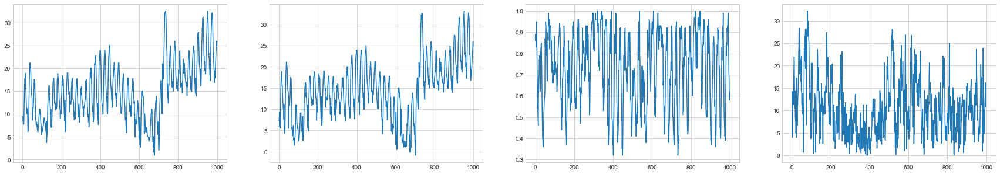

In [34]:
plot_data(input_, 4, target)

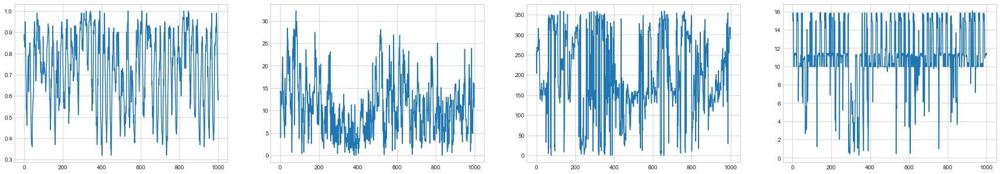

In [56]:
plot_data(input_, 4, target2)

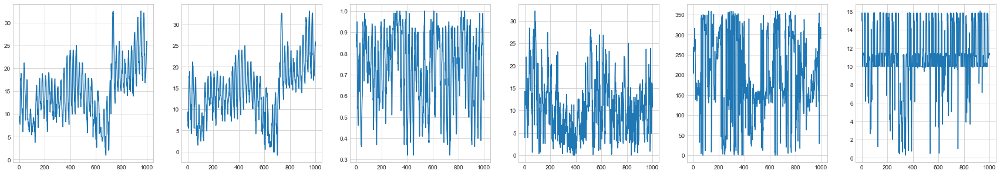

In [90]:
plot_data(input_, target3.size(0), target3)

# Test1

0th additional rbflayer
0th additional RBFlayer 0th epoch loss: 1225.9193768811883
0th additional RBFlayer 999th epoch MSE Loss: 101.29190756881184
0th additional RBFlayer 1999th epoch MSE Loss: 94.66310101607093
0th additional RBFlayer 2999th epoch MSE Loss: 91.96034663898911
0th additional RBFlayer best loss : 91.96034663898911


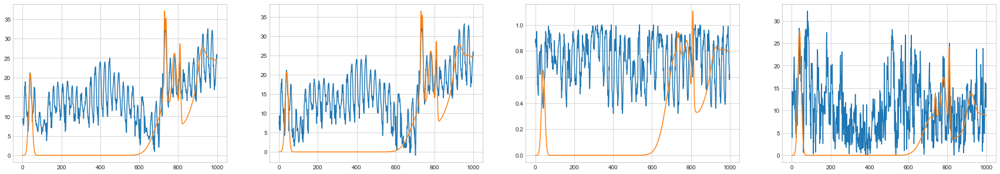

1th additional rbflayer
1th additional RBFlayer 0th epoch loss: 1489.9424262623588
1th additional RBFlayer 999th epoch MSE Loss: 44.272900088518895
1th additional RBFlayer 1999th epoch MSE Loss: 33.197097800798076
1th additional RBFlayer 2999th epoch MSE Loss: 29.172208559738035
1th additional RBFlayer best loss : 29.169403139456556


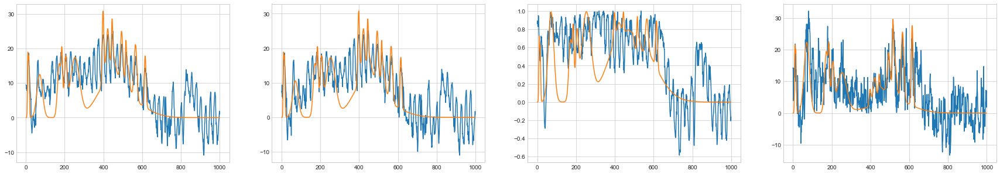

2th additional rbflayer
2th additional RBFlayer 0th epoch loss: 385.68287715818684
2th additional RBFlayer 999th epoch MSE Loss: 21.19553712920689
2th additional RBFlayer 1999th epoch MSE Loss: 19.350219135910233
2th additional RBFlayer 2999th epoch MSE Loss: 18.77555959489862
2th additional RBFlayer best loss : 18.775109468895398
change lr  0.0001
----------------------------------------------


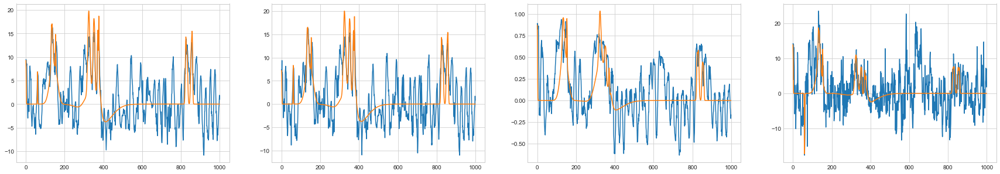

3th additional rbflayer
3th additional RBFlayer 0th epoch loss: 45.562963578811654
3th additional RBFlayer 999th epoch MSE Loss: 11.343638100395175
3th additional RBFlayer 1999th epoch MSE Loss: 11.212754806955848
3th additional RBFlayer 2999th epoch MSE Loss: 11.048014202051789
3th additional RBFlayer best loss : 11.048014202051789


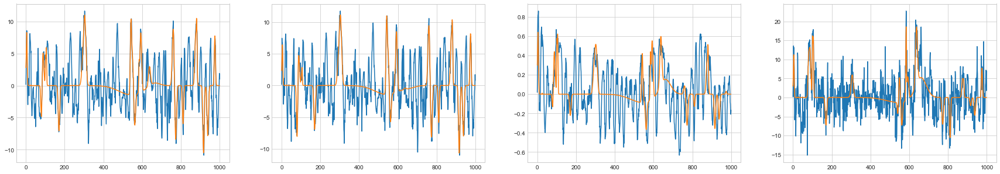

4th additional rbflayer
4th additional RBFlayer 0th epoch loss: 31.007614963575435
4th additional RBFlayer 999th epoch MSE Loss: 7.419537641569379
4th additional RBFlayer 1999th epoch MSE Loss: 7.225060317842446
4th additional RBFlayer 2999th epoch MSE Loss: 7.12390963315525
4th additional RBFlayer best loss : 7.129914571645932


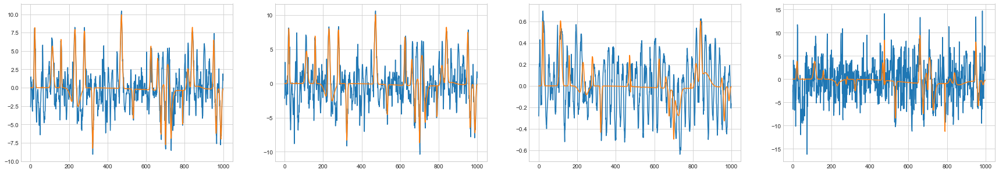

5th additional rbflayer
5th additional RBFlayer 0th epoch loss: 13.496402128986329
5th additional RBFlayer 999th epoch MSE Loss: 5.800453956939467
5th additional RBFlayer 1999th epoch MSE Loss: 5.631801634323287
5th additional RBFlayer 2999th epoch MSE Loss: 5.56771285966848
5th additional RBFlayer best loss : 5.56814395854994


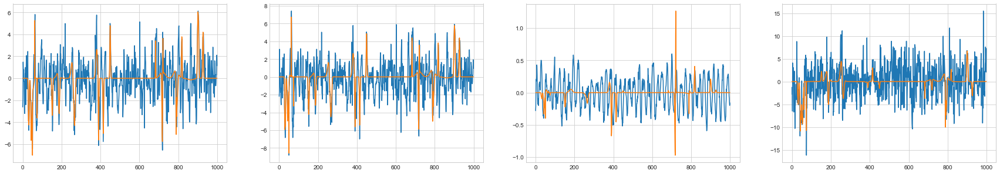

6th additional rbflayer
6th additional RBFlayer 0th epoch loss: 10.957467139261427
6th additional RBFlayer 999th epoch MSE Loss: 4.842210920338996
6th additional RBFlayer 1999th epoch MSE Loss: 4.788390956338779
6th additional RBFlayer 2999th epoch MSE Loss: 4.757596136867218
6th additional RBFlayer best loss : 4.757596084636393


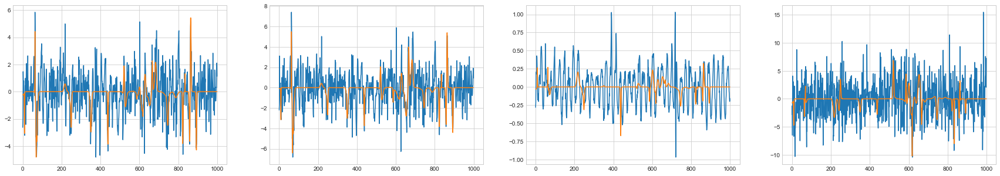

7th additional rbflayer
7th additional RBFlayer 0th epoch loss: 12.81512307305751
7th additional RBFlayer 999th epoch MSE Loss: 4.367371995953571
7th additional RBFlayer 1999th epoch MSE Loss: 4.318098516663311
7th additional RBFlayer 2999th epoch MSE Loss: 4.353902635675638
7th additional RBFlayer best loss : 4.31781593478236


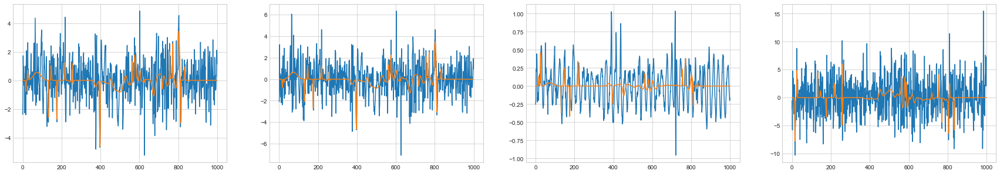

8th additional rbflayer
8th additional RBFlayer 0th epoch loss: 8.839538205112888
8th additional RBFlayer 999th epoch MSE Loss: 4.079092022709805
8th additional RBFlayer 1999th epoch MSE Loss: 3.9972934357975007
8th additional RBFlayer 2999th epoch MSE Loss: 3.9730810099231357
8th additional RBFlayer best loss : 3.9730661581357003


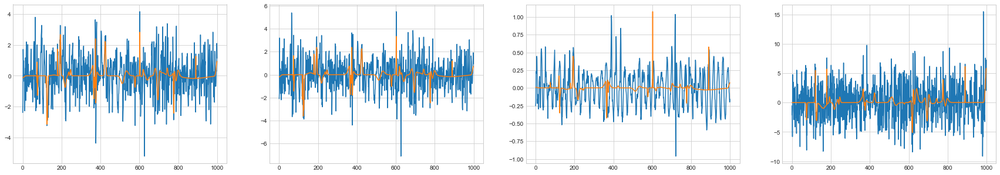

In [48]:
model = MultiRBFnn(target.size(0), 50, device)
model.train(input_, target, 3000, 0.00001, 4, 20)

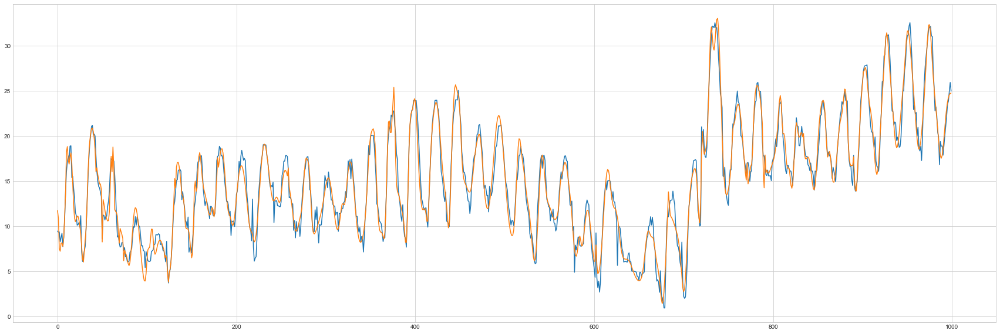

In [49]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), target[0].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model.pred(input_)[1][0].cpu().detach().numpy())
plt.show()

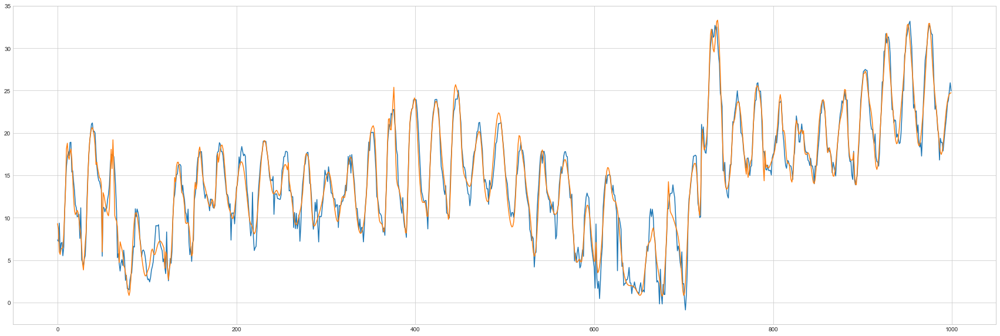

In [50]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), target[1].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model.pred(input_)[1][1].cpu().detach().numpy())
plt.show()

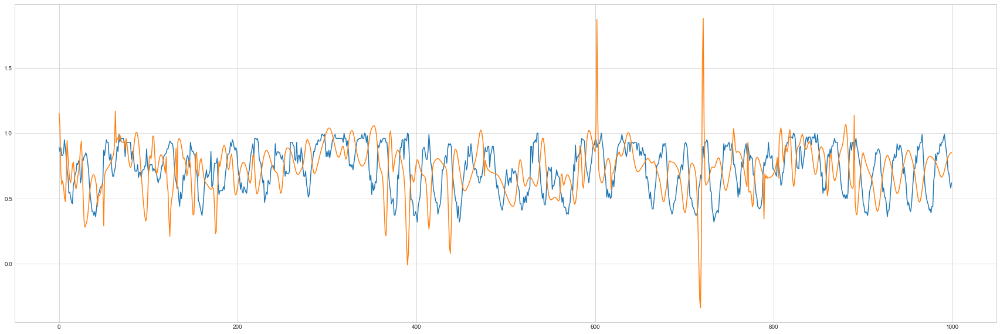

In [51]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), target[2].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model.pred(input_)[1][2].cpu().detach().numpy())
plt.show()

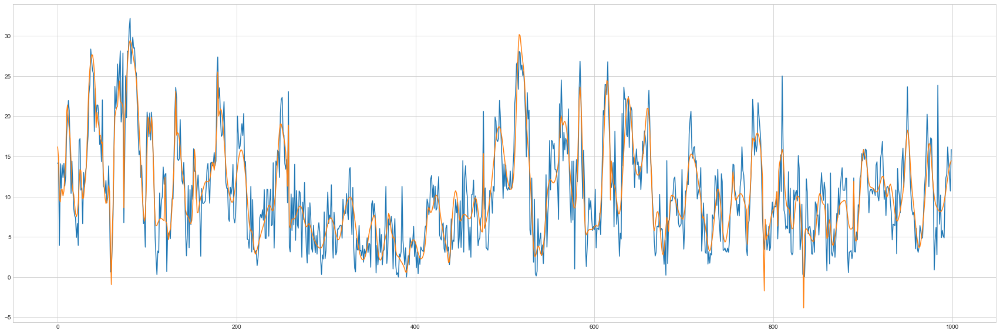

In [52]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), target[3].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model.pred(input_)[1][3].cpu().detach().numpy())
plt.show()

# Test2

0th additional rbflayer
0th additional RBFlayer 0th epoch loss: 100776.42973923653
0th additional RBFlayer 999th epoch MSE Loss: 4016.363800106847
0th additional RBFlayer 1999th epoch MSE Loss: 3347.529379692446
0th additional RBFlayer 2999th epoch MSE Loss: 3072.7580900222265
0th additional RBFlayer best loss : 3072.7580900222265


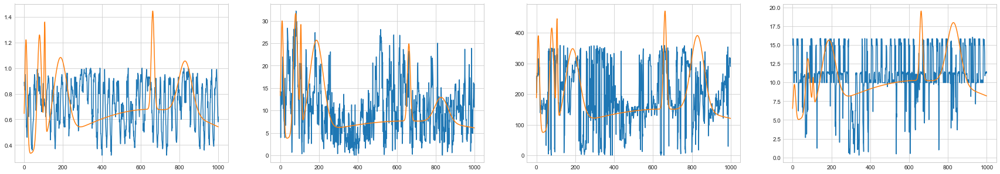

1th additional rbflayer
1th additional RBFlayer 0th epoch loss: 63022.951724122824
1th additional RBFlayer 999th epoch MSE Loss: 3376.8083393763554
1th additional RBFlayer 1999th epoch MSE Loss: 2743.1036922897238
1th additional RBFlayer 2999th epoch MSE Loss: 2450.1746725121275
1th additional RBFlayer best loss : 2450.034002237926


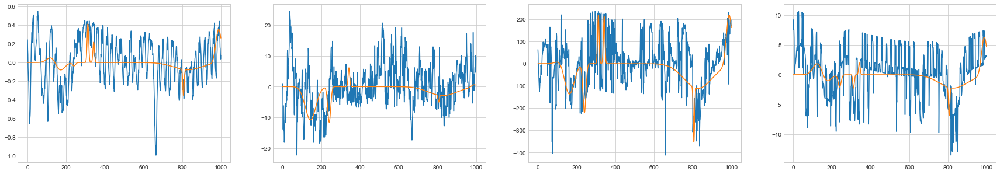

2th additional rbflayer
2th additional RBFlayer 0th epoch loss: 85211.63139255246
2th additional RBFlayer 999th epoch MSE Loss: 3213.7334084370364
2th additional RBFlayer 1999th epoch MSE Loss: 2410.044956686877
2th additional RBFlayer 2999th epoch MSE Loss: 2112.627293644335
2th additional RBFlayer best loss : 2112.4058651719643


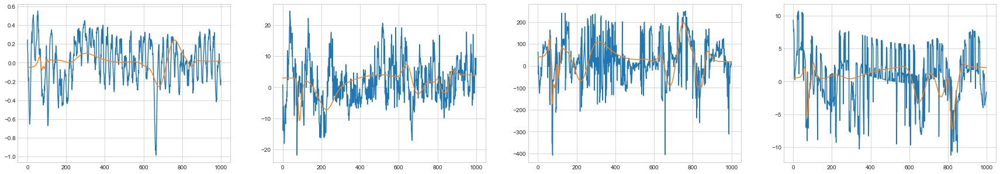

3th additional rbflayer
3th additional RBFlayer 0th epoch loss: 29499.808361962892
3th additional RBFlayer 999th epoch MSE Loss: 2059.1081710915996
3th additional RBFlayer 1999th epoch MSE Loss: 1823.016202072631
3th additional RBFlayer 2999th epoch MSE Loss: 1758.0152639488367
3th additional RBFlayer best loss : 1757.972834465823


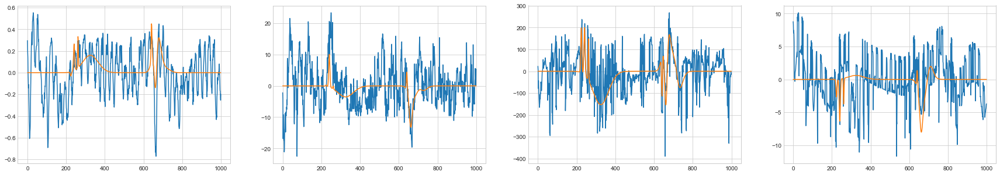

4th additional rbflayer
4th additional RBFlayer 0th epoch loss: 56949.558367625315
4th additional RBFlayer 999th epoch MSE Loss: 2689.1660360957017
4th additional RBFlayer 1999th epoch MSE Loss: 2132.1267727702457
4th additional RBFlayer 2999th epoch MSE Loss: 1971.8851446851374
4th additional RBFlayer best loss : 1971.6449700772393


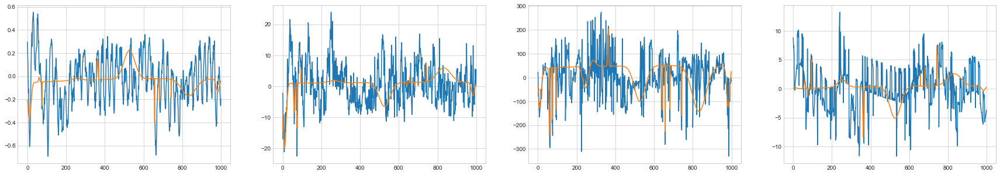

5th additional rbflayer
5th additional RBFlayer 0th epoch loss: 14728.369375486764
5th additional RBFlayer 999th epoch MSE Loss: 1798.8066041409543
5th additional RBFlayer 1999th epoch MSE Loss: 1578.0472787645745
5th additional RBFlayer 2999th epoch MSE Loss: 1506.2287256397228
5th additional RBFlayer best loss : 1505.7533382130973


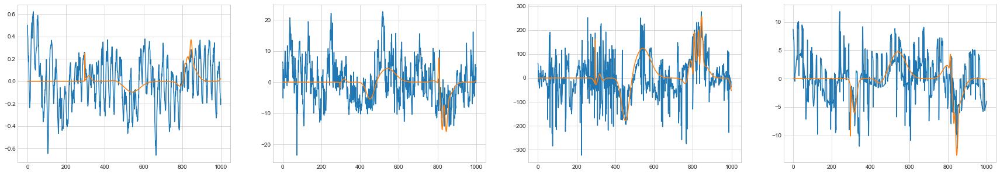

6th additional rbflayer
6th additional RBFlayer 0th epoch loss: 32888.65595381591
6th additional RBFlayer 999th epoch MSE Loss: 2018.9602192791083
6th additional RBFlayer 1999th epoch MSE Loss: 1669.1107371273645
6th additional RBFlayer 2999th epoch MSE Loss: 1574.1493481835757
6th additional RBFlayer best loss : 1574.0801195411157


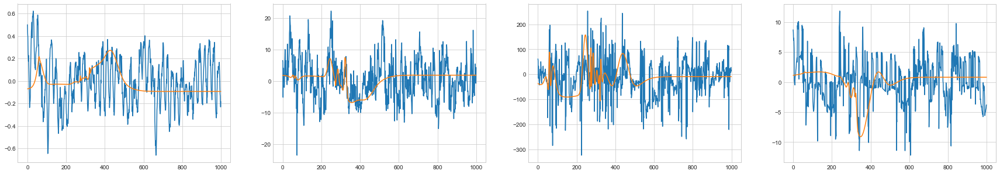

7th additional rbflayer
7th additional RBFlayer 0th epoch loss: 14790.853924668352
7th additional RBFlayer 999th epoch MSE Loss: 2332.3493675151667
7th additional RBFlayer 1999th epoch MSE Loss: 1683.5710359137097
7th additional RBFlayer 2999th epoch MSE Loss: 1512.2229838019366
7th additional RBFlayer best loss : 1512.336495144192


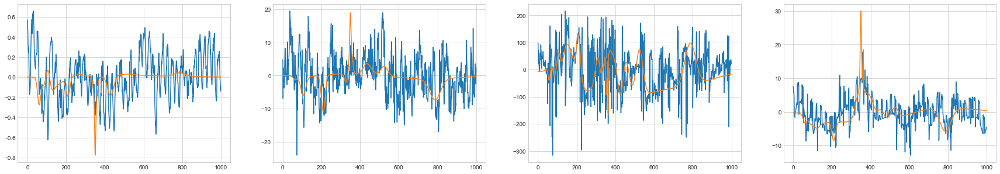

8th additional rbflayer
8th additional RBFlayer 0th epoch loss: 15310.598639819362
8th additional RBFlayer 999th epoch MSE Loss: 2055.3462994356787
8th additional RBFlayer 1999th epoch MSE Loss: 1559.2371434630725
8th additional RBFlayer 2999th epoch MSE Loss: 1449.3590702036536
8th additional RBFlayer best loss : 1449.290884220615


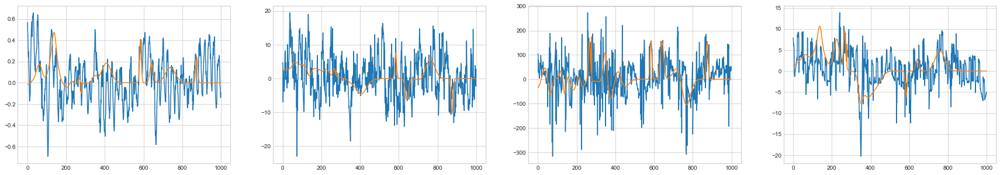

9th additional rbflayer
9th additional RBFlayer 0th epoch loss: 7555.803425128457
9th additional RBFlayer 999th epoch MSE Loss: 1992.1349583707386
9th additional RBFlayer 1999th epoch MSE Loss: 1635.792396030555
9th additional RBFlayer 2999th epoch MSE Loss: 1540.7915911963912
9th additional RBFlayer best loss : 1540.7097711051506


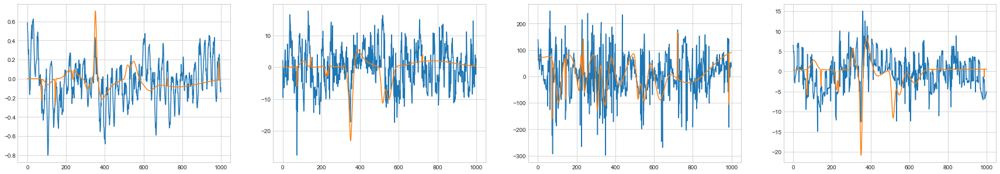

10th additional rbflayer
10th additional RBFlayer 0th epoch loss: 11044.01379432328
10th additional RBFlayer 999th epoch MSE Loss: 1692.0184583763146
10th additional RBFlayer 1999th epoch MSE Loss: 1479.04980604537
10th additional RBFlayer 2999th epoch MSE Loss: 1415.4005443138208
10th additional RBFlayer best loss : 1415.5707436621724


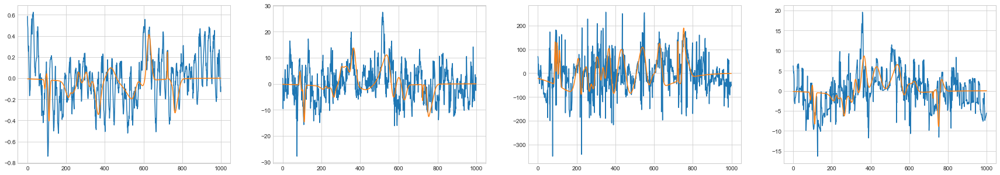

11th additional rbflayer
11th additional RBFlayer 0th epoch loss: 10393.153575713566
11th additional RBFlayer 999th epoch MSE Loss: 1715.7358871224976
11th additional RBFlayer 1999th epoch MSE Loss: 1422.0293627170465
11th additional RBFlayer 2999th epoch MSE Loss: 1369.058662818487
11th additional RBFlayer best loss : 1359.3788944956125


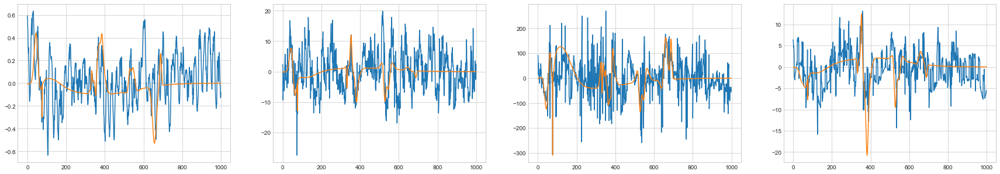

12th additional rbflayer
12th additional RBFlayer 0th epoch loss: 10289.698345627616
12th additional RBFlayer 999th epoch MSE Loss: 1564.061364912362
12th additional RBFlayer 1999th epoch MSE Loss: 1280.4656610120196
12th additional RBFlayer 2999th epoch MSE Loss: 1268.434701105075
12th additional RBFlayer best loss : 1257.2995450409087


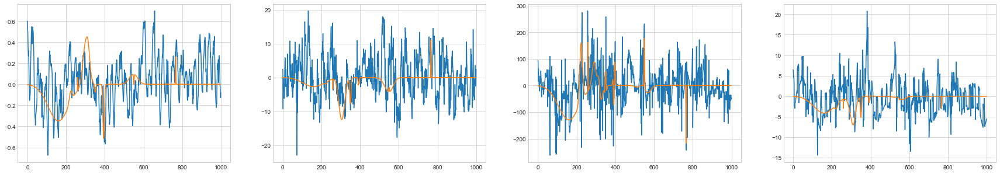

13th additional rbflayer
13th additional RBFlayer 0th epoch loss: 8167.362041744806
13th additional RBFlayer 999th epoch MSE Loss: 1910.1585113853944
13th additional RBFlayer 1999th epoch MSE Loss: 1482.8172236132912
13th additional RBFlayer 2999th epoch MSE Loss: 1309.0966728692188
13th additional RBFlayer best loss : 1311.0758783956576


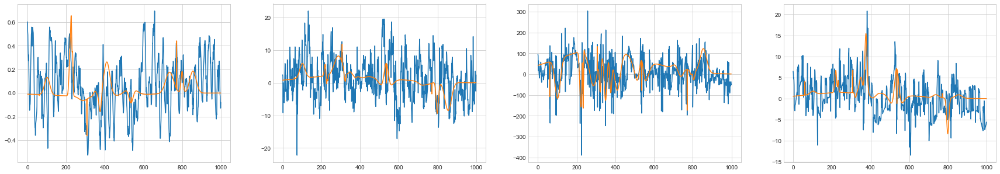

14th additional rbflayer
14th additional RBFlayer 0th epoch loss: 29196.425468228088
14th additional RBFlayer 999th epoch MSE Loss: 2190.3547389242617
14th additional RBFlayer 1999th epoch MSE Loss: 1578.5037026513592
14th additional RBFlayer 2999th epoch MSE Loss: 1423.9583496857397
14th additional RBFlayer best loss : 1425.3204015493184


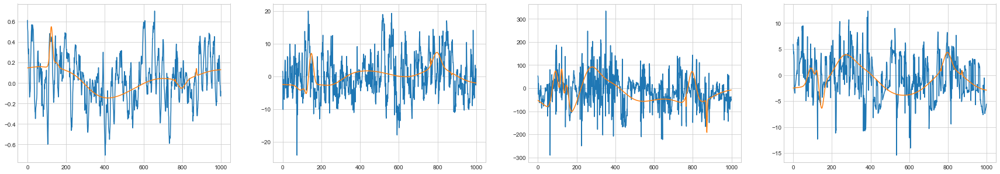

15th additional rbflayer
15th additional RBFlayer 0th epoch loss: 5589.274337704156
15th additional RBFlayer 999th epoch MSE Loss: 1470.9670379406684
15th additional RBFlayer 1999th epoch MSE Loss: 1174.8371054945994
15th additional RBFlayer 2999th epoch MSE Loss: 1118.4437455747054
15th additional RBFlayer best loss : 1118.4437455747054


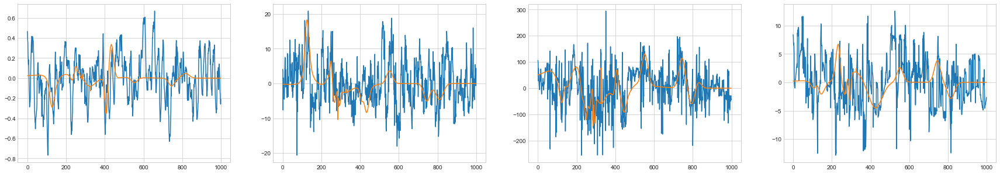

16th additional rbflayer
16th additional RBFlayer 0th epoch loss: 10021.552577076869
16th additional RBFlayer 999th epoch MSE Loss: 1968.401155920085
16th additional RBFlayer 1999th epoch MSE Loss: 1480.9906311043069
16th additional RBFlayer 2999th epoch MSE Loss: 1247.615157903209
16th additional RBFlayer best loss : 1247.4186970078958


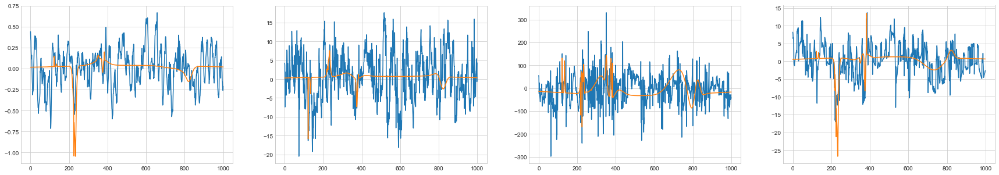

17th additional rbflayer
17th additional RBFlayer 0th epoch loss: 12342.223926913864
17th additional RBFlayer 999th epoch MSE Loss: 1470.8419728843169
17th additional RBFlayer 1999th epoch MSE Loss: 1138.633825107502
17th additional RBFlayer 2999th epoch MSE Loss: 1039.2714742368978
17th additional RBFlayer best loss : 1039.2098405127078


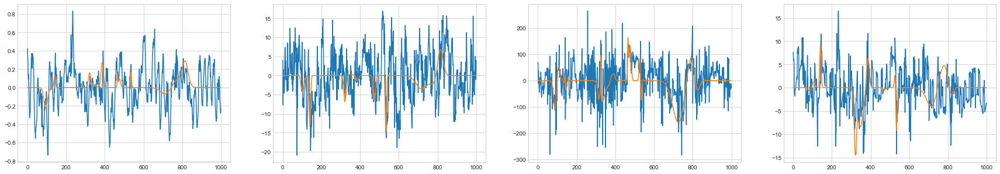

18th additional rbflayer
18th additional RBFlayer 0th epoch loss: 5865.219892576703
18th additional RBFlayer 999th epoch MSE Loss: 1366.8687093707556
18th additional RBFlayer 1999th epoch MSE Loss: 1136.5801508385753
18th additional RBFlayer 2999th epoch MSE Loss: 1067.6688298550603
18th additional RBFlayer best loss : 1067.6363340144349


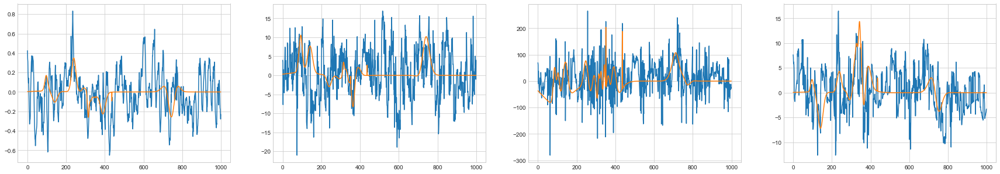

19th additional rbflayer
19th additional RBFlayer 0th epoch loss: 5364.16454978684
19th additional RBFlayer 999th epoch MSE Loss: 1411.890808184388
19th additional RBFlayer 1999th epoch MSE Loss: 1204.4500969587687
19th additional RBFlayer 2999th epoch MSE Loss: 1100.4769935046238
19th additional RBFlayer best loss : 1100.616578520935


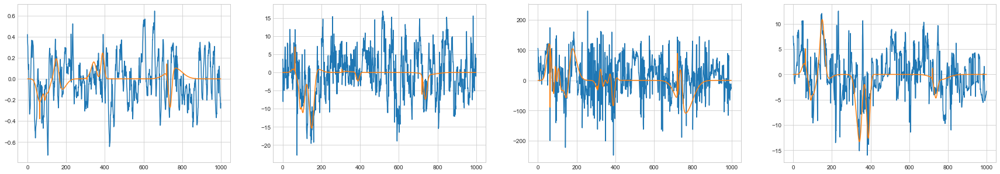

20th additional rbflayer
20th additional RBFlayer 0th epoch loss: 6672.2509265812705
20th additional RBFlayer 999th epoch MSE Loss: 1319.12559119017
20th additional RBFlayer 1999th epoch MSE Loss: 1032.4211037779123
20th additional RBFlayer 2999th epoch MSE Loss: 960.6646320010666
20th additional RBFlayer best loss : 960.6646320010666


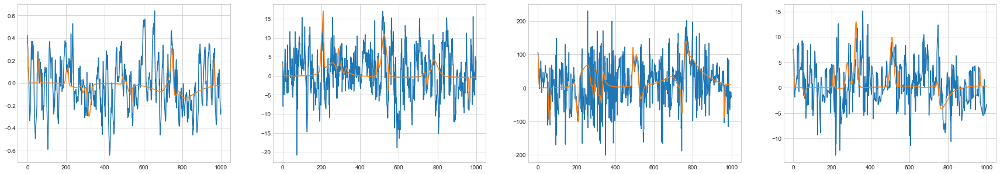

21th additional rbflayer
21th additional RBFlayer 0th epoch loss: 7181.522504329888
21th additional RBFlayer 999th epoch MSE Loss: 1383.0965358378774
21th additional RBFlayer 1999th epoch MSE Loss: 1105.538021081855
21th additional RBFlayer 2999th epoch MSE Loss: 998.3673871064656
21th additional RBFlayer best loss : 999.0574683887791


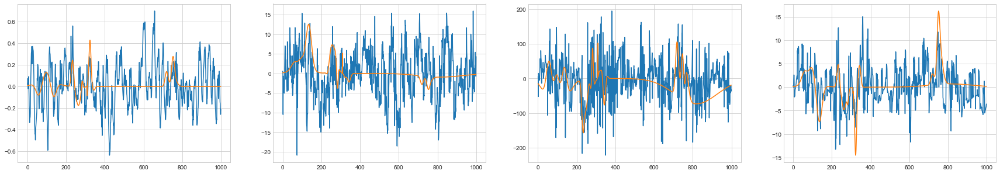

22th additional rbflayer
22th additional RBFlayer 0th epoch loss: 5810.324780056342
22th additional RBFlayer 999th epoch MSE Loss: 2151.309250358078
22th additional RBFlayer 1999th epoch MSE Loss: 1453.0426957599643


KeyboardInterrupt: 

In [58]:
model2 = MultiRBFnn(target2.size(0), 50, device)
model2.train(input_, target2, 3000, 0.000001, 4, 20)

# nomalize

In [63]:
target.size()

torch.Size([4, 1000])

In [59]:
nomal_target1 = nn.functional.normalize(target, dim = 1)

In [60]:
nomal_target2 = nn.functional.normalize(target2, dim = 1)

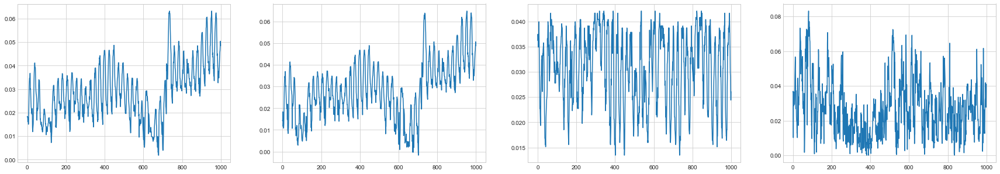

In [64]:
plot_data(input_, 4, nomal_target1)

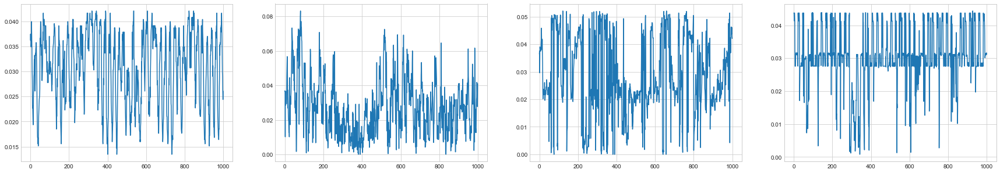

In [65]:
plot_data(input_, 4, nomal_target2)

0th additional rbflayer
0th additional RBFlayer 0th epoch loss: 0.001784433438164327
0th additional RBFlayer 999th epoch MSE Loss: 0.0007775894877033409
0th additional RBFlayer 1999th epoch MSE Loss: 0.0007471425052436184
0th additional RBFlayer 2999th epoch MSE Loss: 0.0007387977619432247
0th additional RBFlayer best loss : 0.0007387977619432247
change round number 6
----------------------------------------------


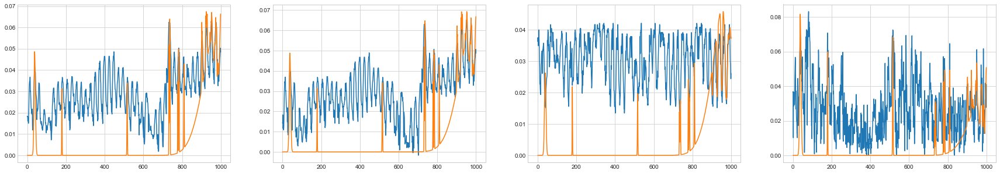

1th additional rbflayer
1th additional RBFlayer 0th epoch loss: 0.0006969735575504734
1th additional RBFlayer 999th epoch MSE Loss: 0.0006296840649258366
1th additional RBFlayer 1999th epoch MSE Loss: 0.0006211833178003305
1th additional RBFlayer 2999th epoch MSE Loss: 0.0006190435698515732
1th additional RBFlayer best loss : 0.0006190424365268843


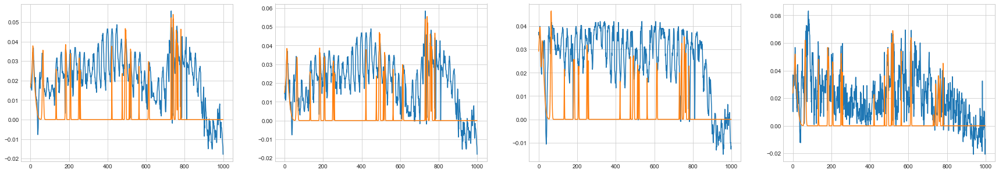

2th additional rbflayer
2th additional RBFlayer 0th epoch loss: 0.0006995877379424767
2th additional RBFlayer 999th epoch MSE Loss: 0.0005193264202045523
2th additional RBFlayer 1999th epoch MSE Loss: 0.000513523596464672
2th additional RBFlayer 2999th epoch MSE Loss: 0.0005114875155201853
2th additional RBFlayer best loss : 0.0005114861820809218


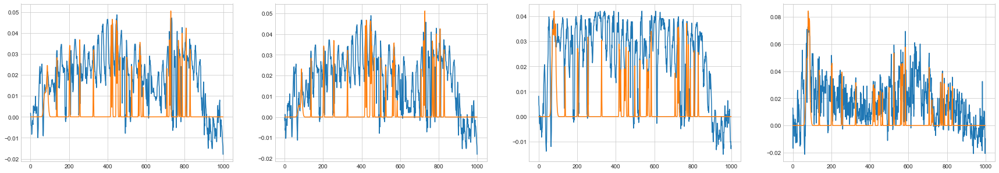

3th additional rbflayer
3th additional RBFlayer 0th epoch loss: 0.00045868415088665983
3th additional RBFlayer 999th epoch MSE Loss: 0.00043624459981878516
3th additional RBFlayer 1999th epoch MSE Loss: 0.00043215475589853004
3th additional RBFlayer 2999th epoch MSE Loss: 0.0004312111648507028
3th additional RBFlayer best loss : 0.00043121068757270267


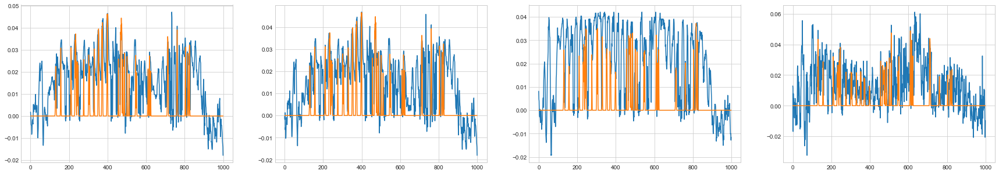

4th additional rbflayer
4th additional RBFlayer 0th epoch loss: 0.00037195555068024325
4th additional RBFlayer 999th epoch MSE Loss: 0.0003577024184151981
4th additional RBFlayer 1999th epoch MSE Loss: 0.00035445877550271715
4th additional RBFlayer 2999th epoch MSE Loss: 0.0003534789798267701
4th additional RBFlayer best loss : 0.0003534784275289902


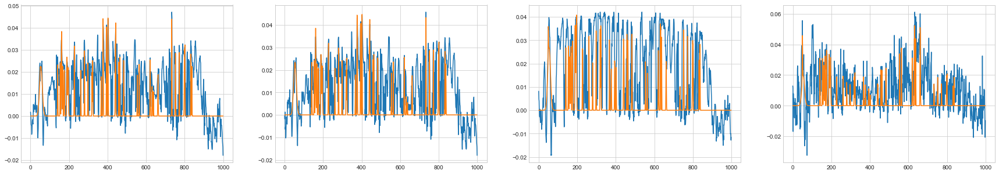

5th additional rbflayer
5th additional RBFlayer 0th epoch loss: 0.0003075012895741561
5th additional RBFlayer 999th epoch MSE Loss: 0.0002915912182789266
5th additional RBFlayer 1999th epoch MSE Loss: 0.0002883572402525785
5th additional RBFlayer 2999th epoch MSE Loss: 0.00028747567365800225
5th additional RBFlayer best loss : 0.00028747518272201176


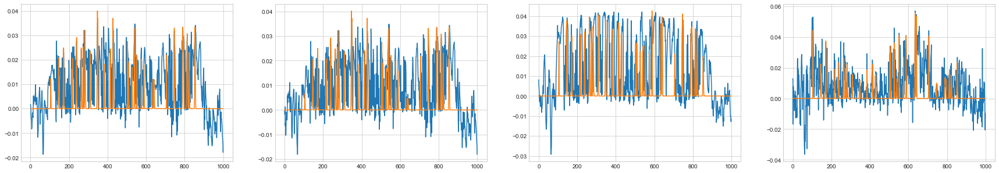

6th additional rbflayer
6th additional RBFlayer 0th epoch loss: 0.000245328068658955
6th additional RBFlayer 999th epoch MSE Loss: 0.0002344685567597359
6th additional RBFlayer 1999th epoch MSE Loss: 0.00023173966022514147
6th additional RBFlayer 2999th epoch MSE Loss: 0.00023088145801416875
6th additional RBFlayer best loss : 0.00023088094889052007


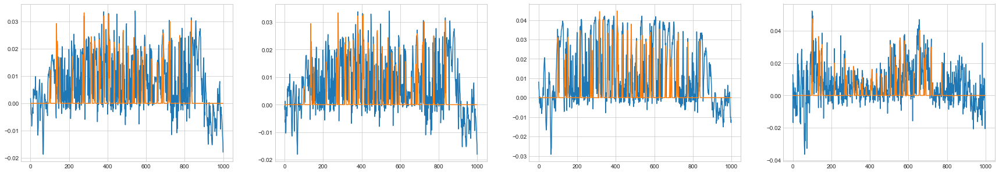

7th additional rbflayer
7th additional RBFlayer 0th epoch loss: 0.00019743956244338502
7th additional RBFlayer 999th epoch MSE Loss: 0.00018642788351926022
7th additional RBFlayer 1999th epoch MSE Loss: 0.00018402043245796567
7th additional RBFlayer 2999th epoch MSE Loss: 0.00018332225659993082
7th additional RBFlayer best loss : 0.00018332185586943762


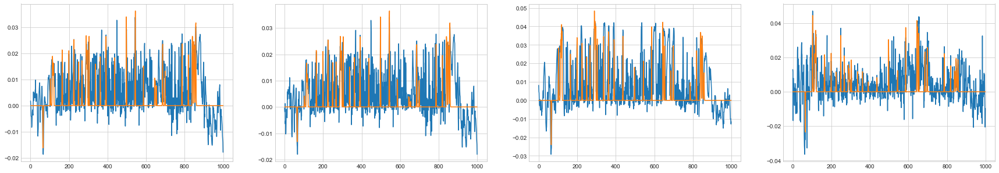

8th additional rbflayer
8th additional RBFlayer 0th epoch loss: 0.00014438699207668841
8th additional RBFlayer 999th epoch MSE Loss: 0.00014052993466330432
8th additional RBFlayer 1999th epoch MSE Loss: 0.00013925114965904057
8th additional RBFlayer 2999th epoch MSE Loss: 0.00013875840781035404
8th additional RBFlayer best loss : 0.0001387580951614831


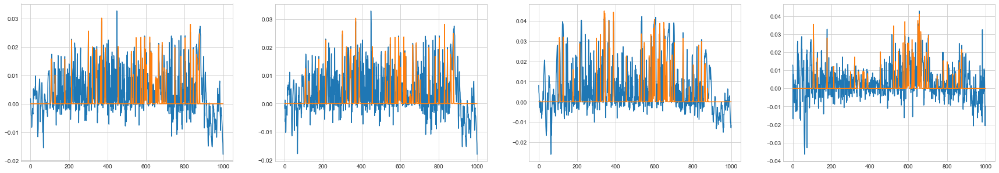

9th additional rbflayer
9th additional RBFlayer 0th epoch loss: 0.00011238369671498656
9th additional RBFlayer 999th epoch MSE Loss: 0.00011071383123049003
9th additional RBFlayer 1999th epoch MSE Loss: 0.00011010102197261216
9th additional RBFlayer 2999th epoch MSE Loss: 0.0001098462215641781
9th additional RBFlayer best loss : 0.0001098460545495405


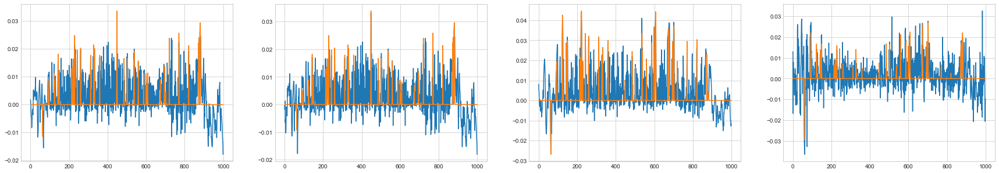

10th additional rbflayer
10th additional RBFlayer 0th epoch loss: 9.695422896063099e-05
10th additional RBFlayer 999th epoch MSE Loss: 9.278402162558056e-05
10th additional RBFlayer 1999th epoch MSE Loss: 9.265695540014188e-05
10th additional RBFlayer 2999th epoch MSE Loss: 9.259239058037812e-05
10th additional RBFlayer best loss : 9.259234408305511e-05
change lr  0.001
----------------------------------------------


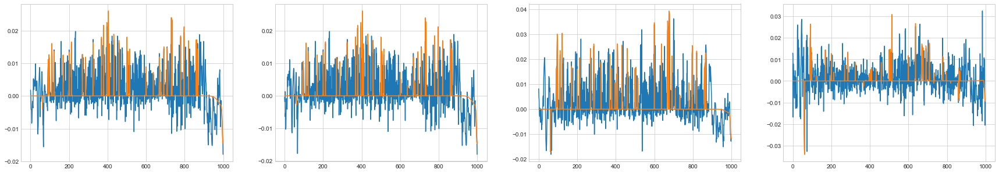

11th additional rbflayer
11th additional RBFlayer 0th epoch loss: 8.042612259931515e-05
11th additional RBFlayer 999th epoch MSE Loss: 8.021794810935976e-05
11th additional RBFlayer 1999th epoch MSE Loss: 8.018909655516987e-05
11th additional RBFlayer 2999th epoch MSE Loss: 8.016122674506715e-05
11th additional RBFlayer best loss : 8.016119887128593e-05


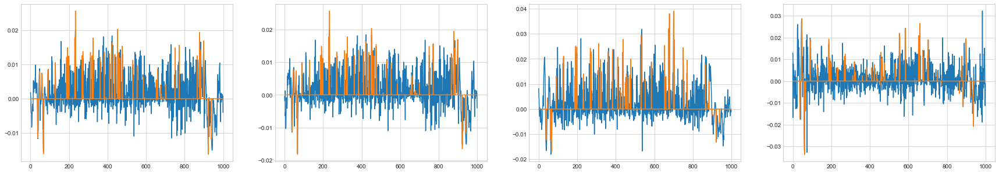

12th additional rbflayer
12th additional RBFlayer 0th epoch loss: 7.169608586167927e-05
12th additional RBFlayer 999th epoch MSE Loss: 7.169070416813045e-05
12th additional RBFlayer 1999th epoch MSE Loss: 7.168844316055068e-05
12th additional RBFlayer 2999th epoch MSE Loss: 7.168621966239414e-05
12th additional RBFlayer best loss : 7.168621743240536e-05


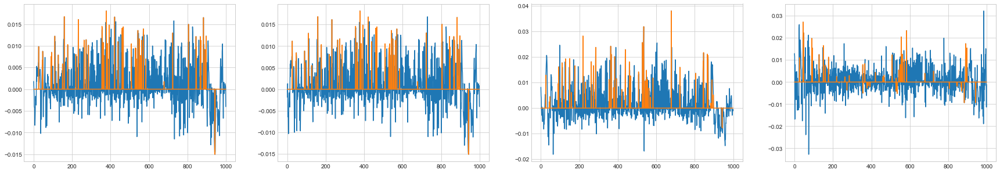

13th additional rbflayer
13th additional RBFlayer 0th epoch loss: 6.498657028305085e-05
13th additional RBFlayer 999th epoch MSE Loss: 6.498657028200717e-05
13th additional RBFlayer 1999th epoch MSE Loss: 6.49865702809628e-05
13th additional RBFlayer 2999th epoch MSE Loss: 6.498657027991844e-05
13th additional RBFlayer best loss : 6.498657027991741e-05


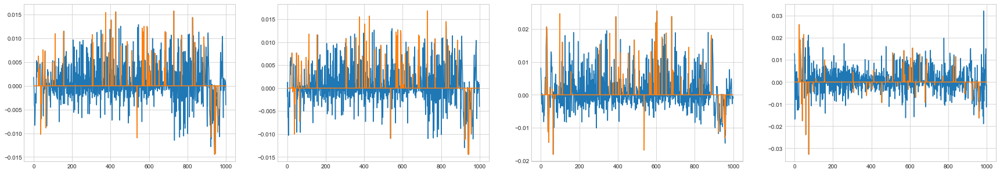

14th additional rbflayer
14th additional RBFlayer 0th epoch loss: 5.998624879276165e-05
14th additional RBFlayer 999th epoch MSE Loss: 5.998624879276165e-05
14th additional RBFlayer 1999th epoch MSE Loss: 5.998624879276165e-05
14th additional RBFlayer 2999th epoch MSE Loss: 5.998624879276165e-05
14th additional RBFlayer best loss : 5.998624879276165e-05


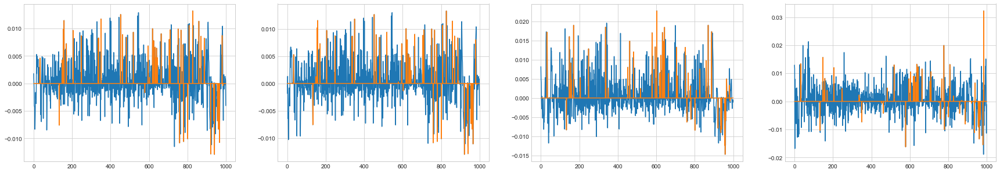

15th additional rbflayer
15th additional RBFlayer 0th epoch loss: 5.6284134886001814e-05
15th additional RBFlayer 999th epoch MSE Loss: 5.6284134878248475e-05
15th additional RBFlayer 1999th epoch MSE Loss: 5.628413487048741e-05
15th additional RBFlayer 2999th epoch MSE Loss: 5.628413486272635e-05
15th additional RBFlayer best loss : 5.6284134862718586e-05


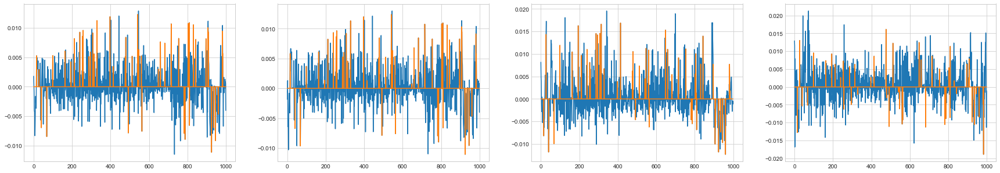

16th additional rbflayer
16th additional RBFlayer 0th epoch loss: 5.30010337581703e-05
16th additional RBFlayer 999th epoch MSE Loss: 5.2997811932857984e-05
16th additional RBFlayer 1999th epoch MSE Loss: 5.299746641271307e-05
16th additional RBFlayer 2999th epoch MSE Loss: 5.299715527662691e-05
16th additional RBFlayer best loss : 5.299715496557872e-05


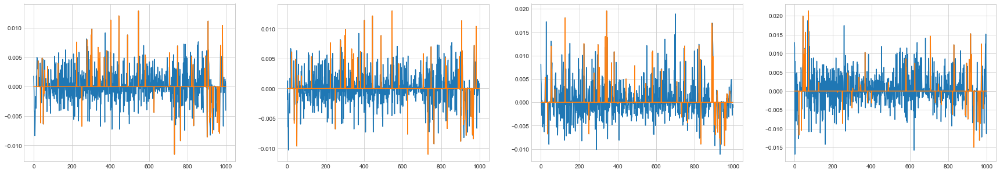

17th additional rbflayer
17th additional RBFlayer 0th epoch loss: 5.055683068943749e-05
17th additional RBFlayer 999th epoch MSE Loss: 5.054549254475342e-05
17th additional RBFlayer 1999th epoch MSE Loss: 5.0545248830823525e-05
17th additional RBFlayer 2999th epoch MSE Loss: 5.0545165139246385e-05
17th additional RBFlayer best loss : 5.054516505730887e-05


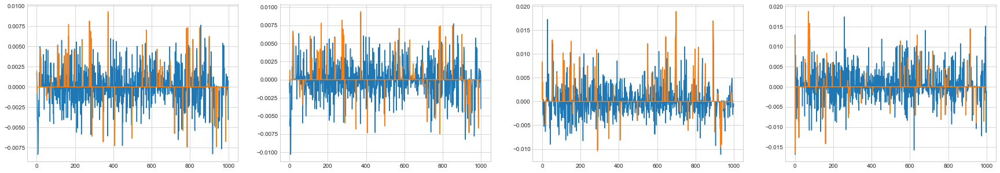

18th additional rbflayer
18th additional RBFlayer 0th epoch loss: 4.870279269118067e-05
18th additional RBFlayer 999th epoch MSE Loss: 4.869913464608945e-05
18th additional RBFlayer 1999th epoch MSE Loss: 4.869895849248422e-05
18th additional RBFlayer 2999th epoch MSE Loss: 4.8698841039884546e-05
18th additional RBFlayer best loss : 4.869884092304083e-05


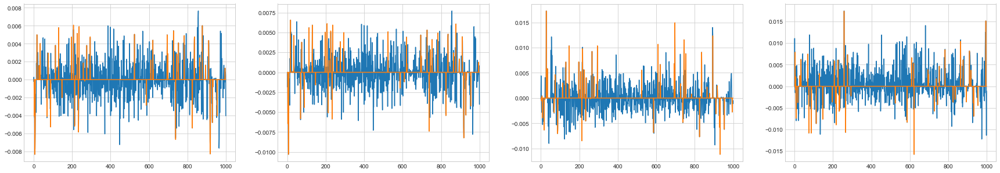

In [72]:
model_nomal1 = MultiRBFnn(nomal_target1.size(0), 50, device)
model_nomal1.train(input_, nomal_target1, 3000, 0.0001, 0.00005, 0.0001)

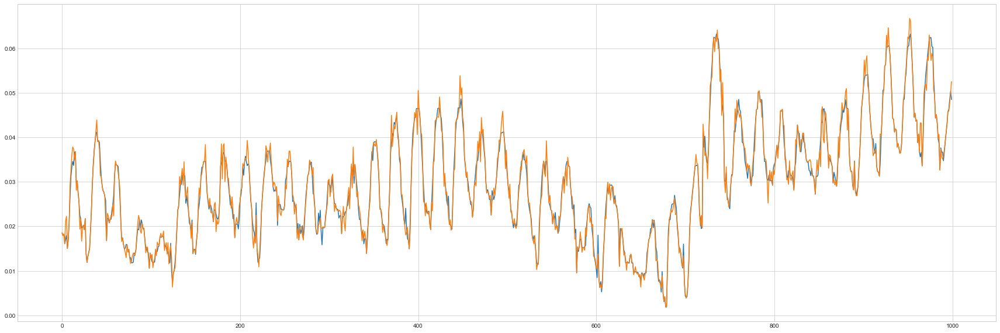

In [73]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), nomal_target1[0].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model_nomal1.pred(input_)[1][0].cpu().detach().numpy())
plt.show()

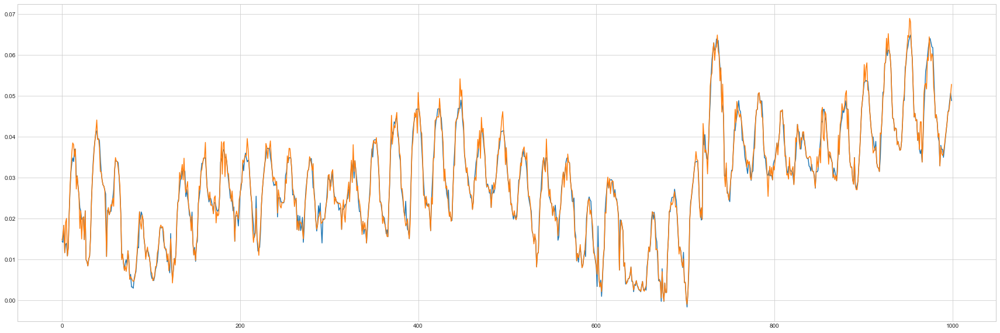

In [74]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), nomal_target1[1].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model_nomal1.pred(input_)[1][1].cpu().detach().numpy())
plt.show()

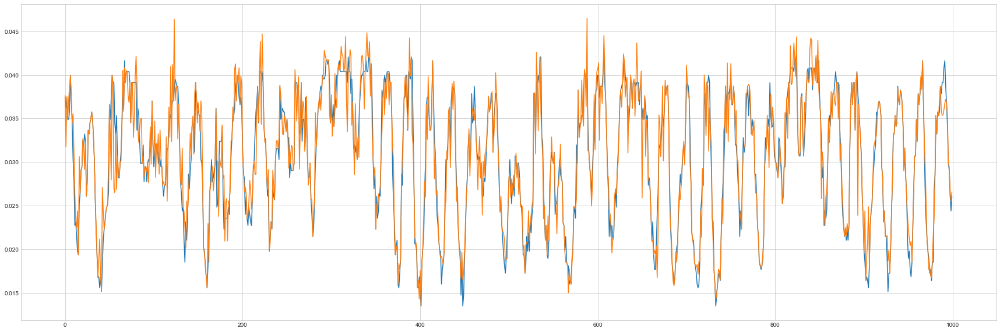

In [75]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), nomal_target1[2].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model_nomal1.pred(input_)[1][2].cpu().detach().numpy())
plt.show()

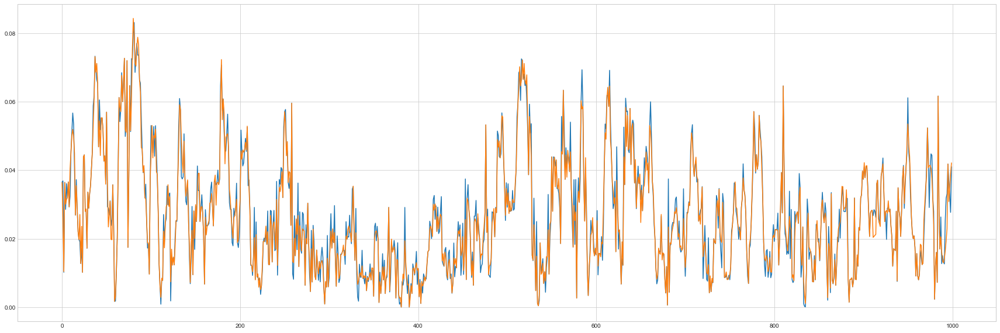

In [76]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), nomal_target1[3].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model_nomal1.pred(input_)[1][3].cpu().detach().numpy())
plt.show()

0th additional rbflayer
0th additional RBFlayer 0th epoch loss: 0.0015127788854887396
0th additional RBFlayer 999th epoch MSE Loss: 0.0008337410492711455
0th additional RBFlayer 1999th epoch MSE Loss: 0.0008272878932106705
0th additional RBFlayer 2999th epoch MSE Loss: 0.0008256906302335311
0th additional RBFlayer best loss : 0.0008256906302335311
change round number 6
----------------------------------------------


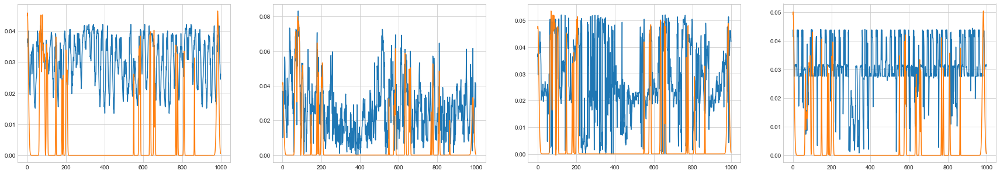

1th additional rbflayer
1th additional RBFlayer 0th epoch loss: 0.0008055005560768569
1th additional RBFlayer 999th epoch MSE Loss: 0.0006944501067137512
1th additional RBFlayer 1999th epoch MSE Loss: 0.0006842690815169008
1th additional RBFlayer 2999th epoch MSE Loss: 0.0006811139835811566
1th additional RBFlayer best loss : 0.0006811118338824229


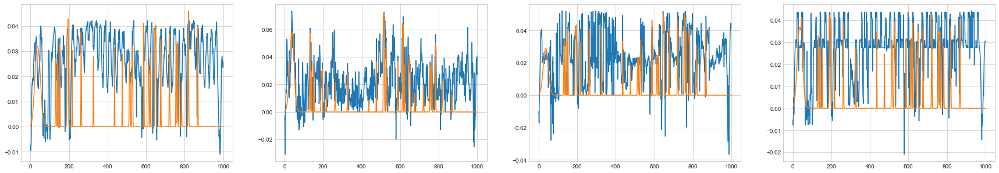

2th additional rbflayer
2th additional RBFlayer 0th epoch loss: 0.0007109110153955896
2th additional RBFlayer 999th epoch MSE Loss: 0.0005386534580465829
2th additional RBFlayer 1999th epoch MSE Loss: 0.0005317279346561386
2th additional RBFlayer 2999th epoch MSE Loss: 0.0005297036438249494
2th additional RBFlayer best loss : 0.0005297024092410661


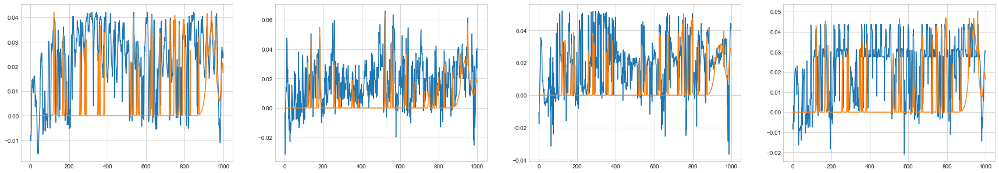

3th additional rbflayer
3th additional RBFlayer 0th epoch loss: 0.00047225169641839884
3th additional RBFlayer 999th epoch MSE Loss: 0.00044073790627646877
3th additional RBFlayer 1999th epoch MSE Loss: 0.00043570564077279023
3th additional RBFlayer 2999th epoch MSE Loss: 0.0004345124145723477
3th additional RBFlayer best loss : 0.00043451176855450313


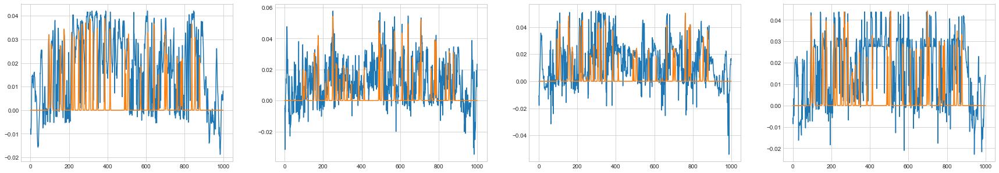

4th additional rbflayer
4th additional RBFlayer 0th epoch loss: 0.0003809259027947775
4th additional RBFlayer 999th epoch MSE Loss: 0.00035377112796371933
4th additional RBFlayer 1999th epoch MSE Loss: 0.00034954075485913686
4th additional RBFlayer 2999th epoch MSE Loss: 0.0003483762360706551
4th additional RBFlayer best loss : 0.00034837556466715716


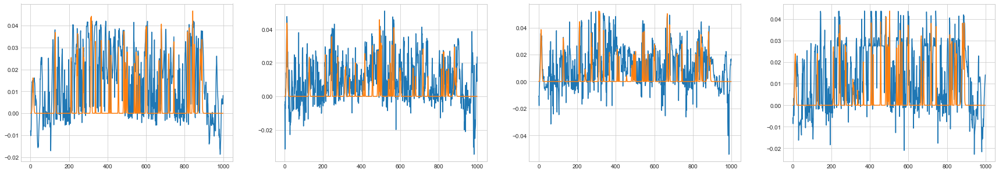

5th additional rbflayer
5th additional RBFlayer 0th epoch loss: 0.00031562355215643457
5th additional RBFlayer 999th epoch MSE Loss: 0.00029569730861875396
5th additional RBFlayer 1999th epoch MSE Loss: 0.0002919076461937605
5th additional RBFlayer 2999th epoch MSE Loss: 0.0002908196227969687
5th additional RBFlayer best loss : 0.0002908189982451455


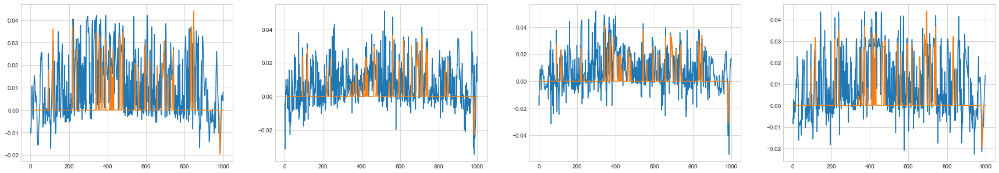

6th additional rbflayer
6th additional RBFlayer 0th epoch loss: 0.00025317163060550776
6th additional RBFlayer 999th epoch MSE Loss: 0.00023880216586255322
6th additional RBFlayer 1999th epoch MSE Loss: 0.00023564948545710528
6th additional RBFlayer 2999th epoch MSE Loss: 0.0002347220610131085
6th additional RBFlayer best loss : 0.000234721535556881


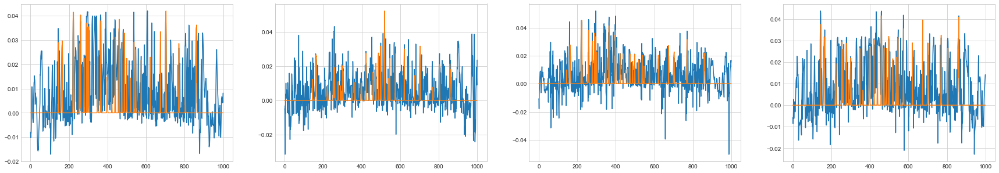

7th additional rbflayer
7th additional RBFlayer 0th epoch loss: 0.00019293805017957623
7th additional RBFlayer 999th epoch MSE Loss: 0.00018576642345496786
7th additional RBFlayer 1999th epoch MSE Loss: 0.00018400477854563208
7th additional RBFlayer 2999th epoch MSE Loss: 0.00018345959320997956
7th additional RBFlayer best loss : 0.00018345927379087302


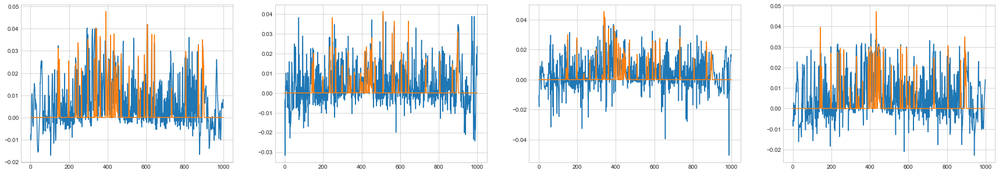

8th additional rbflayer
8th additional RBFlayer 0th epoch loss: 0.00015245924514853377
8th additional RBFlayer 999th epoch MSE Loss: 0.00014646560997380197
8th additional RBFlayer 1999th epoch MSE Loss: 0.00014509671932995549
8th additional RBFlayer 2999th epoch MSE Loss: 0.00014463046206515472
8th additional RBFlayer best loss : 0.00014463016438030966


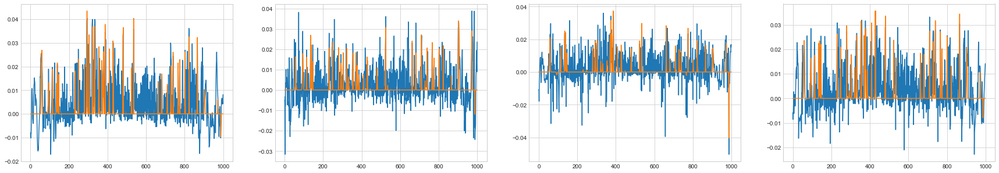

9th additional rbflayer
9th additional RBFlayer 0th epoch loss: 0.00012257688798520097
9th additional RBFlayer 999th epoch MSE Loss: 0.00012090668932058225
9th additional RBFlayer 1999th epoch MSE Loss: 0.00012040417824492284
9th additional RBFlayer 2999th epoch MSE Loss: 0.00012017537935727313
9th additional RBFlayer best loss : 0.00012017522135285626


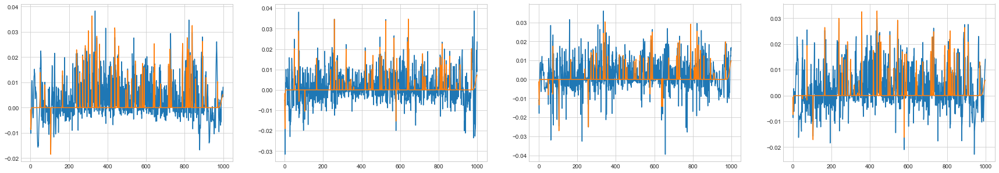

10th additional rbflayer
10th additional RBFlayer 0th epoch loss: 0.00010631968743688892
10th additional RBFlayer 999th epoch MSE Loss: 0.00010555037266707171
10th additional RBFlayer 1999th epoch MSE Loss: 0.00010523035018651583
10th additional RBFlayer 2999th epoch MSE Loss: 0.00010508568022172151
10th additional RBFlayer best loss : 0.00010508558231337595


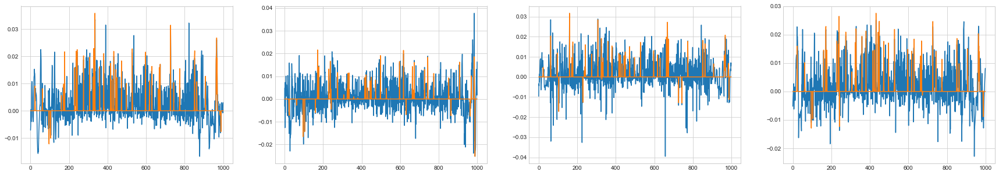

11th additional rbflayer
11th additional RBFlayer 0th epoch loss: 9.557268789024639e-05
11th additional RBFlayer 999th epoch MSE Loss: 9.555434266724805e-05
11th additional RBFlayer 1999th epoch MSE Loss: 9.55427925531821e-05
11th additional RBFlayer 2999th epoch MSE Loss: 9.553542729695905e-05
11th additional RBFlayer best loss : 9.553542142838718e-05
change lr  0.001
----------------------------------------------


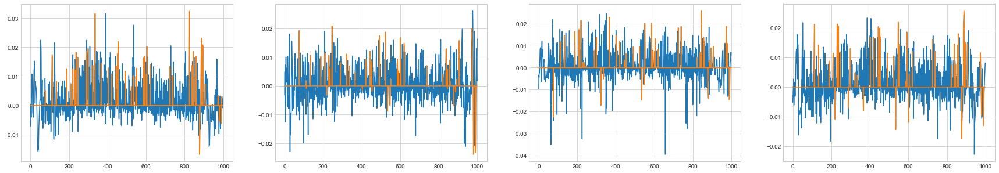

12th additional rbflayer
12th additional RBFlayer 0th epoch loss: 8.741048630512e-05
12th additional RBFlayer 999th epoch MSE Loss: 8.741048845380054e-05
12th additional RBFlayer 1999th epoch MSE Loss: 8.74104906132285e-05
12th additional RBFlayer 2999th epoch MSE Loss: 8.741049277331464e-05
12th additional RBFlayer best loss : 8.741048630512e-05


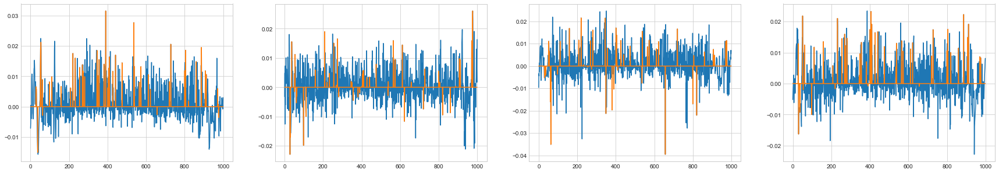

13th additional rbflayer
13th additional RBFlayer 0th epoch loss: 8.11018390914707e-05
13th additional RBFlayer 999th epoch MSE Loss: 8.11018390914707e-05
13th additional RBFlayer 1999th epoch MSE Loss: 8.11018390914707e-05
13th additional RBFlayer 2999th epoch MSE Loss: 8.11018390914707e-05
13th additional RBFlayer best loss : 8.11018390914707e-05


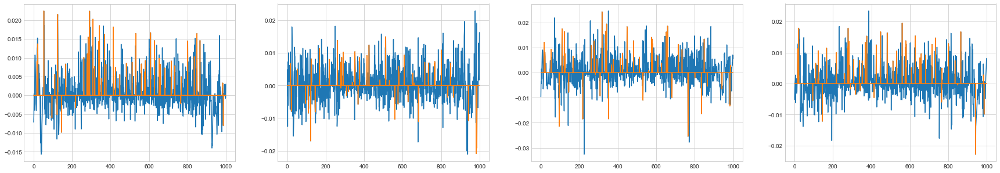

14th additional rbflayer
14th additional RBFlayer 0th epoch loss: 7.58194590890677e-05
14th additional RBFlayer 999th epoch MSE Loss: 7.581883702281961e-05
14th additional RBFlayer 1999th epoch MSE Loss: 7.58188069437616e-05
14th additional RBFlayer 2999th epoch MSE Loss: 7.581878341211185e-05
14th additional RBFlayer best loss : 7.581878338867721e-05


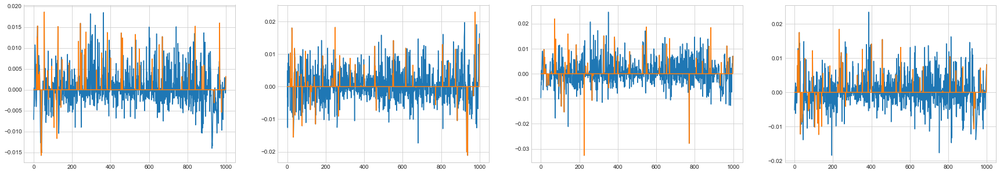

15th additional rbflayer
15th additional RBFlayer 0th epoch loss: 7.166780994835149e-05
15th additional RBFlayer 999th epoch MSE Loss: 7.166644663761687e-05
15th additional RBFlayer 1999th epoch MSE Loss: 7.166635422538123e-05
15th additional RBFlayer 2999th epoch MSE Loss: 7.166628274161933e-05
15th additional RBFlayer best loss : 7.166628266978428e-05


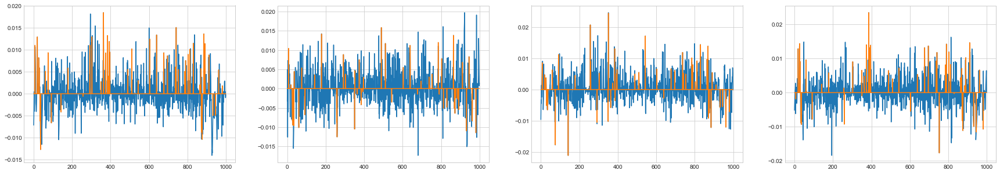

16th additional rbflayer
16th additional RBFlayer 0th epoch loss: 6.82951602367737e-05
16th additional RBFlayer 999th epoch MSE Loss: 6.829481927228416e-05
16th additional RBFlayer 1999th epoch MSE Loss: 6.829469971878563e-05
16th additional RBFlayer 2999th epoch MSE Loss: 6.829458363219472e-05
16th additional RBFlayer best loss : 6.829458351589296e-05


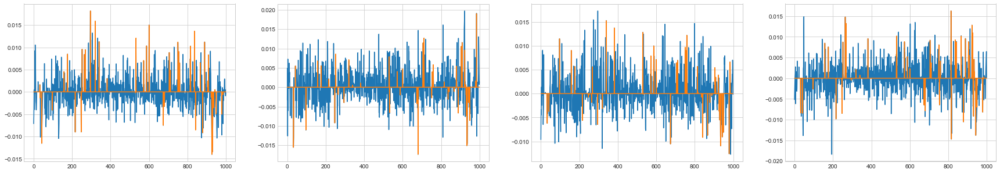

17th additional rbflayer
17th additional RBFlayer 0th epoch loss: 6.564575039878852e-05
17th additional RBFlayer 999th epoch MSE Loss: 6.563420954225509e-05
17th additional RBFlayer 1999th epoch MSE Loss: 6.563378557888569e-05
17th additional RBFlayer 2999th epoch MSE Loss: 6.563351092397214e-05
17th additional RBFlayer best loss : 6.563351065034123e-05


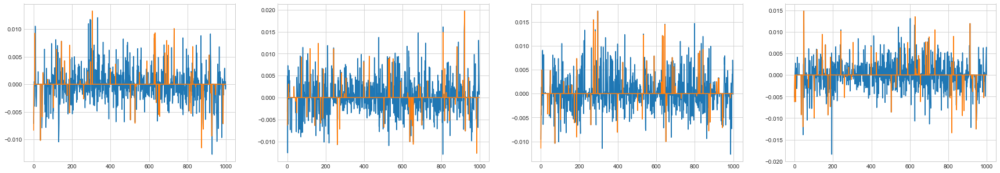

18th additional rbflayer
18th additional RBFlayer 0th epoch loss: 6.366787751576957e-05
18th additional RBFlayer 999th epoch MSE Loss: 6.357623972264251e-05
18th additional RBFlayer 1999th epoch MSE Loss: 6.357482656378264e-05
18th additional RBFlayer 2999th epoch MSE Loss: 6.357437322239213e-05
18th additional RBFlayer best loss : 6.357437278011808e-05


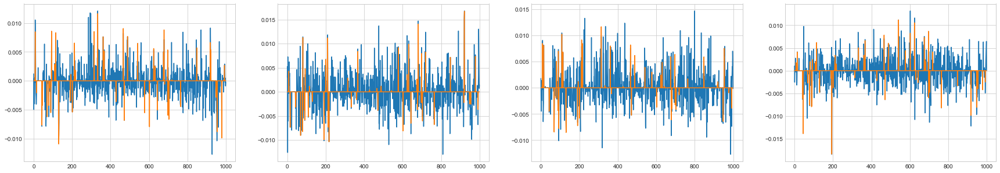

19th additional rbflayer
19th additional RBFlayer 0th epoch loss: 6.184115714244018e-05
19th additional RBFlayer 999th epoch MSE Loss: 6.168278423968855e-05
19th additional RBFlayer 1999th epoch MSE Loss: 6.167899393342477e-05
19th additional RBFlayer 2999th epoch MSE Loss: 6.167655981405912e-05
19th additional RBFlayer best loss : 6.1676557393734e-05


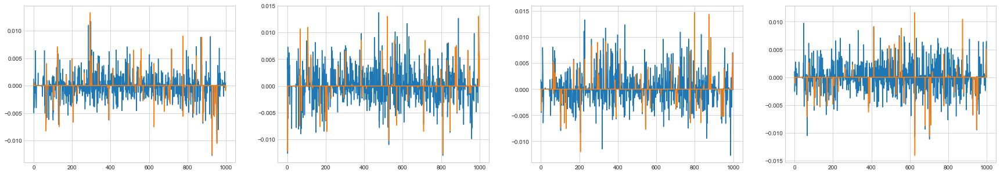

20th additional rbflayer
20th additional RBFlayer 0th epoch loss: 6.066421898557435e-05
20th additional RBFlayer 999th epoch MSE Loss: 6.050685958974573e-05
20th additional RBFlayer 1999th epoch MSE Loss: 6.05048730945726e-05
20th additional RBFlayer 2999th epoch MSE Loss: 6.0504181791186e-05
20th additional RBFlayer best loss : 6.0504181113576267e-05


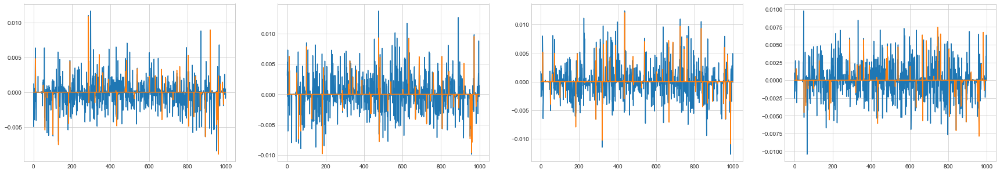

21th additional rbflayer
21th additional RBFlayer 0th epoch loss: 6.0002332506956335e-05
21th additional RBFlayer 999th epoch MSE Loss: 5.958280555498813e-05
21th additional RBFlayer 1999th epoch MSE Loss: 5.9579005068386174e-05
21th additional RBFlayer 2999th epoch MSE Loss: 5.957764989907706e-05
21th additional RBFlayer best loss : 5.9577648560932094e-05


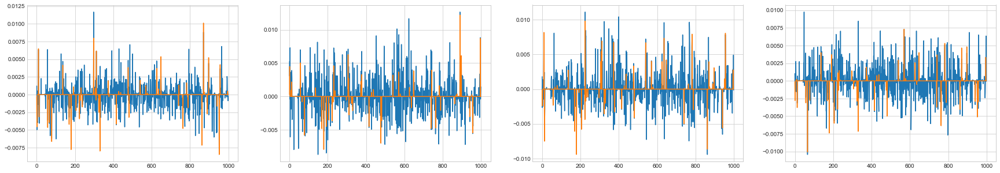

In [79]:
model_nomal2 = MultiRBFnn(nomal_target2.size(0), 50, device)
model_nomal2.train(input_, nomal_target2, 3000, 0.0001, 0.00006, 0.0001)

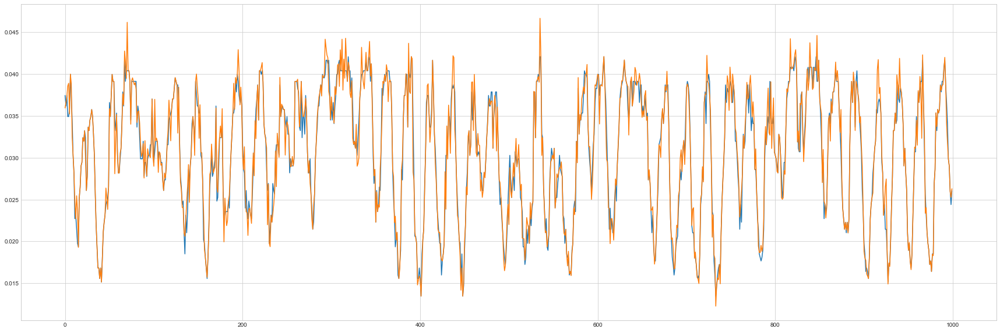

In [80]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), nomal_target2[0].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model_nomal2.pred(input_)[1][0].cpu().detach().numpy())
plt.show()

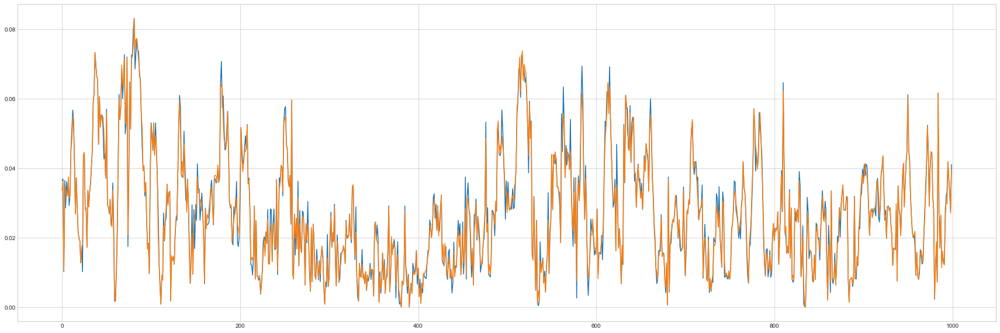

In [81]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), nomal_target2[1].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model_nomal2.pred(input_)[1][1].cpu().detach().numpy())
plt.show()

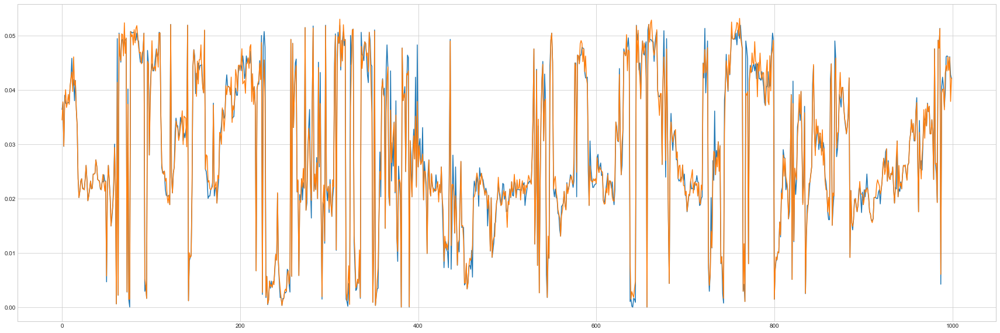

In [82]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), nomal_target2[2].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model_nomal2.pred(input_)[1][2].cpu().detach().numpy())
plt.show()

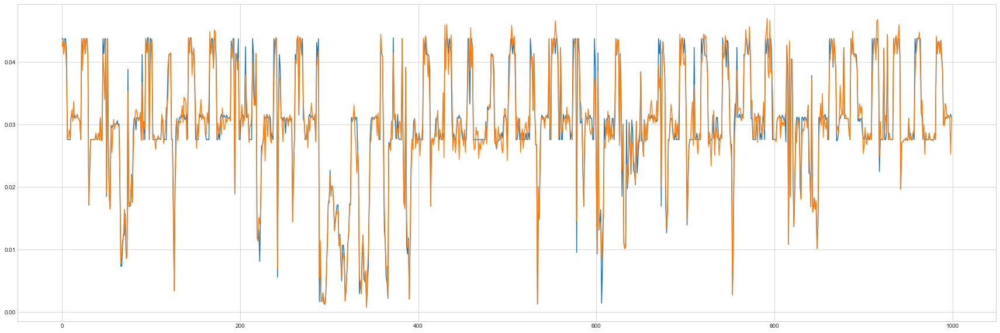

In [83]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), nomal_target2[3].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model_nomal2.pred(input_)[1][3].cpu().detach().numpy())
plt.show()

In [92]:
nomal_target3 = nn.functional.normalize(target3, dim = 1)

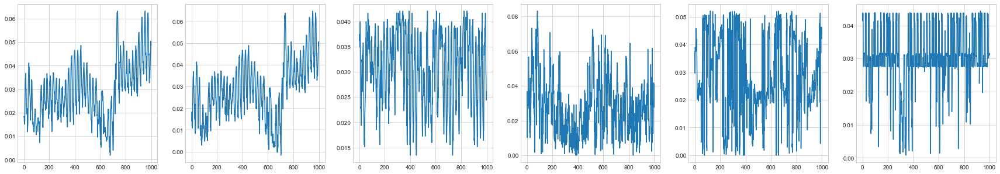

In [93]:
plot_data(input_, nomal_target3.size(0), nomal_target3)

0th additional rbflayer
0th additional RBFlayer 0th epoch loss: 0.003293838078335668
0th additional RBFlayer 999th epoch MSE Loss: 0.0007727655388978556
0th additional RBFlayer 1999th epoch MSE Loss: 0.0007582309806401957
0th additional RBFlayer 2999th epoch MSE Loss: 0.0007543041437615055
0th additional RBFlayer best loss : 0.0007543041437615055
change round number 6
----------------------------------------------


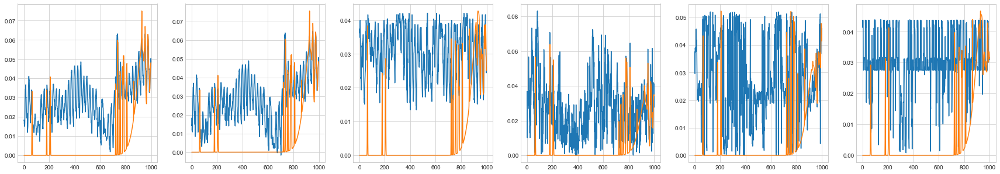

1th additional rbflayer
1th additional RBFlayer 0th epoch loss: 0.0025786351393117936
1th additional RBFlayer 999th epoch MSE Loss: 0.0005282525013464744
1th additional RBFlayer 1999th epoch MSE Loss: 0.0005161170357771819
1th additional RBFlayer 2999th epoch MSE Loss: 0.0005132755808225757
1th additional RBFlayer best loss : 0.0005132740373425033


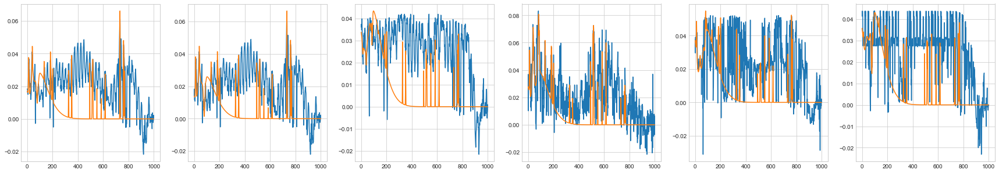

2th additional rbflayer
2th additional RBFlayer 0th epoch loss: 0.0004634476641706873
2th additional RBFlayer 999th epoch MSE Loss: 0.0004447566079325966
2th additional RBFlayer 1999th epoch MSE Loss: 0.0004396916743023616
2th additional RBFlayer 2999th epoch MSE Loss: 0.0004381890290667472
2th additional RBFlayer best loss : 0.00043818822790229616


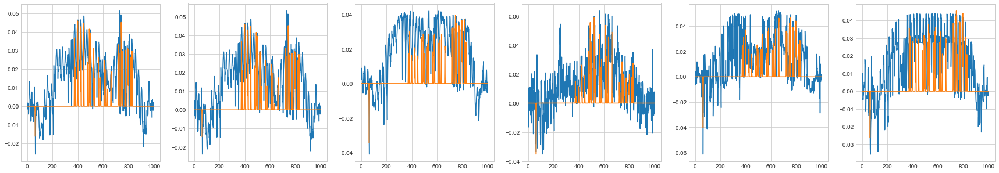

3th additional rbflayer
3th additional RBFlayer 0th epoch loss: 0.000389686963635882
3th additional RBFlayer 999th epoch MSE Loss: 0.00037304229716261165
3th additional RBFlayer 1999th epoch MSE Loss: 0.00036896129980494525
3th additional RBFlayer 2999th epoch MSE Loss: 0.00036784646542120506
3th additional RBFlayer best loss : 0.00036784588702057553


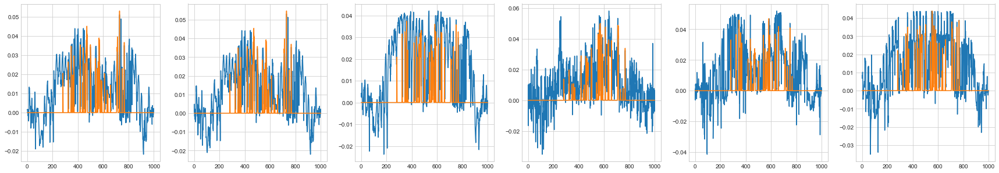

4th additional rbflayer
4th additional RBFlayer 0th epoch loss: 0.0003129498868742566
4th additional RBFlayer 999th epoch MSE Loss: 0.00030237304419552337
4th additional RBFlayer 1999th epoch MSE Loss: 0.0002995136454841459
4th additional RBFlayer 2999th epoch MSE Loss: 0.00029865728269181687
4th additional RBFlayer best loss : 0.00029865681461749684


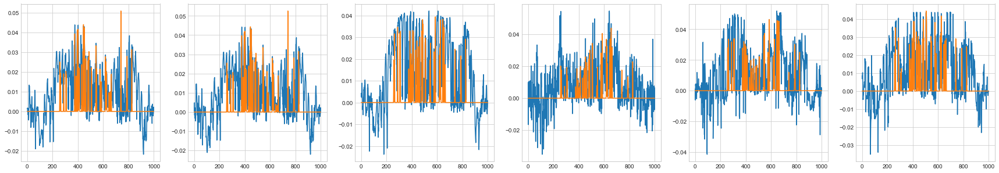

5th additional rbflayer
5th additional RBFlayer 0th epoch loss: 0.00026409478861440147
5th additional RBFlayer 999th epoch MSE Loss: 0.0002478032008168368
5th additional RBFlayer 1999th epoch MSE Loss: 0.00024445557233721053
5th additional RBFlayer 2999th epoch MSE Loss: 0.0002435596936283997
5th additional RBFlayer best loss : 0.00024355920903873263


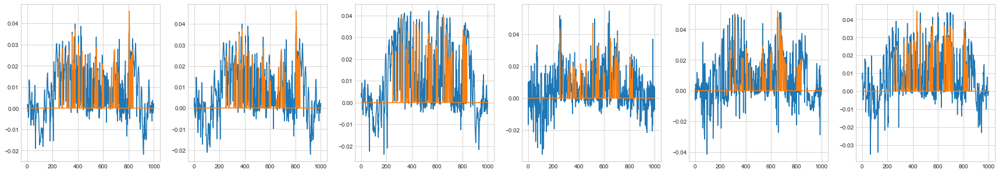

6th additional rbflayer
6th additional RBFlayer 0th epoch loss: 0.00020915726633437457
6th additional RBFlayer 999th epoch MSE Loss: 0.00019921104855266558
6th additional RBFlayer 1999th epoch MSE Loss: 0.00019678772599654307
6th additional RBFlayer 2999th epoch MSE Loss: 0.0001960909417597405
6th additional RBFlayer best loss : 0.00019609056408906818


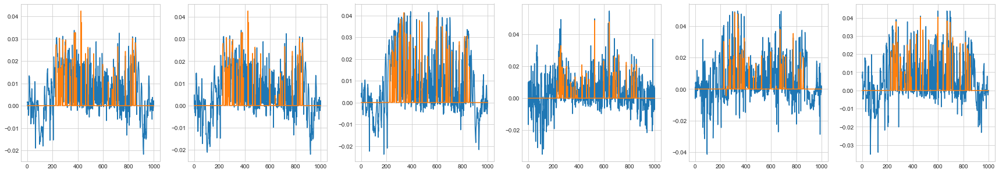

7th additional rbflayer
7th additional RBFlayer 0th epoch loss: 0.00015714952758039458
7th additional RBFlayer 999th epoch MSE Loss: 0.00015452953129907219
7th additional RBFlayer 1999th epoch MSE Loss: 0.00015362322010776568
7th additional RBFlayer 2999th epoch MSE Loss: 0.00015328299211308645
7th additional RBFlayer best loss : 0.00015328278417568156


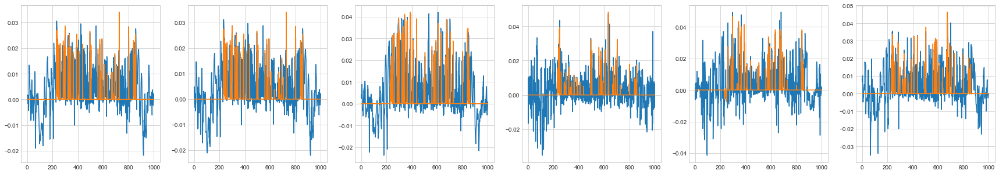

8th additional rbflayer
8th additional RBFlayer 0th epoch loss: 0.00012536791361384745
8th additional RBFlayer 999th epoch MSE Loss: 0.00012423897209953852
8th additional RBFlayer 1999th epoch MSE Loss: 0.0001237545252343802
8th additional RBFlayer 2999th epoch MSE Loss: 0.00012353624463057843
8th additional RBFlayer best loss : 0.00012353609859484368


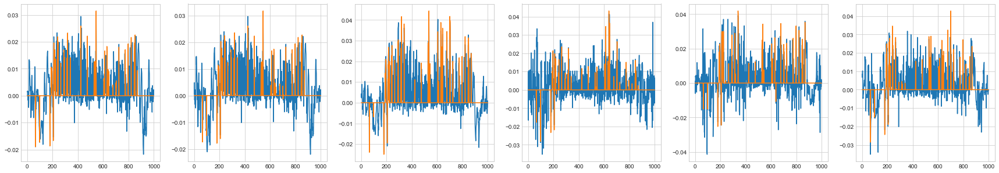

9th additional rbflayer
9th additional RBFlayer 0th epoch loss: 0.0001060126818879958
9th additional RBFlayer 999th epoch MSE Loss: 0.0001058254499543902
9th additional RBFlayer 1999th epoch MSE Loss: 0.00010572352229989008
9th additional RBFlayer 2999th epoch MSE Loss: 0.00010566532465684431
9th additional RBFlayer best loss : 0.00010566528033614594


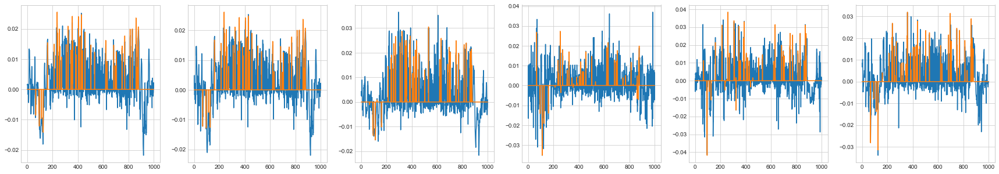

10th additional rbflayer
10th additional RBFlayer 0th epoch loss: 9.345990664424467e-05
10th additional RBFlayer 999th epoch MSE Loss: 9.339396085208046e-05
10th additional RBFlayer 1999th epoch MSE Loss: 9.335755198014087e-05
10th additional RBFlayer 2999th epoch MSE Loss: 9.333687929629372e-05
10th additional RBFlayer best loss : 9.33368637148111e-05
change lr  0.001
----------------------------------------------


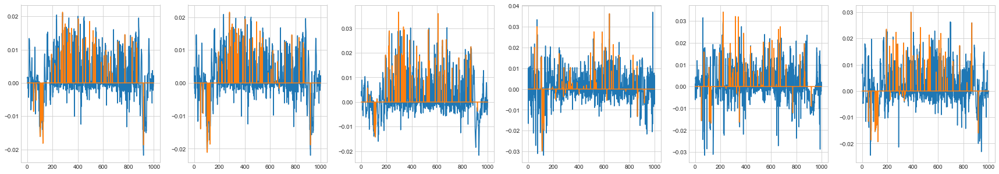

11th additional rbflayer
11th additional RBFlayer 0th epoch loss: 8.335108565936146e-05
11th additional RBFlayer 999th epoch MSE Loss: 8.334858616075972e-05
11th additional RBFlayer 1999th epoch MSE Loss: 8.334666715556109e-05
11th additional RBFlayer 2999th epoch MSE Loss: 8.334474425850673e-05
11th additional RBFlayer best loss : 8.334474232861707e-05


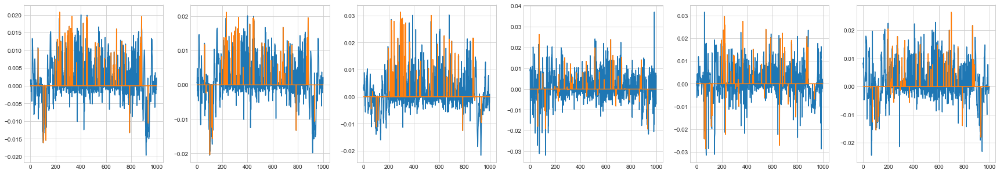

12th additional rbflayer
12th additional RBFlayer 0th epoch loss: 7.538539105514439e-05
12th additional RBFlayer 999th epoch MSE Loss: 7.538539105514439e-05
12th additional RBFlayer 1999th epoch MSE Loss: 7.538539105514439e-05
12th additional RBFlayer 2999th epoch MSE Loss: 7.538539105514439e-05
12th additional RBFlayer best loss : 7.538539105514439e-05


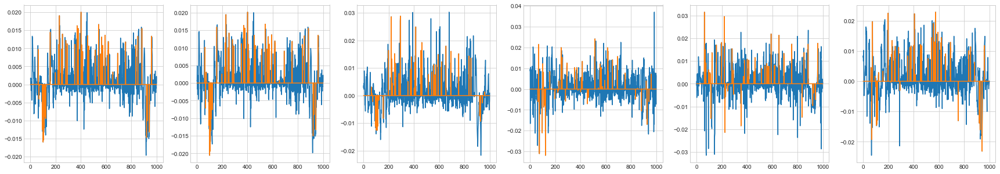

13th additional rbflayer
13th additional RBFlayer 0th epoch loss: 6.835160481064427e-05
13th additional RBFlayer 999th epoch MSE Loss: 6.835160481064427e-05
13th additional RBFlayer 1999th epoch MSE Loss: 6.835160481064427e-05
13th additional RBFlayer 2999th epoch MSE Loss: 6.835160481064427e-05
13th additional RBFlayer best loss : 6.835160481064427e-05


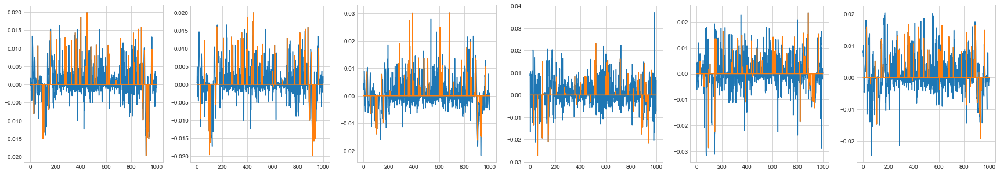

14th additional rbflayer
14th additional RBFlayer 0th epoch loss: 6.232495149354988e-05
14th additional RBFlayer 999th epoch MSE Loss: 6.232495149354988e-05
14th additional RBFlayer 1999th epoch MSE Loss: 6.232495149354988e-05
14th additional RBFlayer 2999th epoch MSE Loss: 6.232495149354988e-05
14th additional RBFlayer best loss : 6.232495149354988e-05


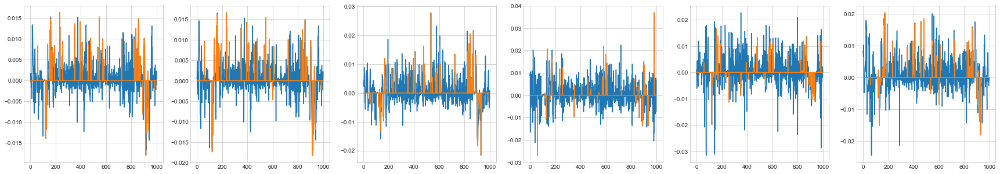

15th additional rbflayer
15th additional RBFlayer 0th epoch loss: 5.710382164021014e-05
15th additional RBFlayer 999th epoch MSE Loss: 5.7103819668524954e-05
15th additional RBFlayer 1999th epoch MSE Loss: 5.710381770692707e-05
15th additional RBFlayer 2999th epoch MSE Loss: 5.710381574510434e-05
15th additional RBFlayer best loss : 5.7103815743142494e-05


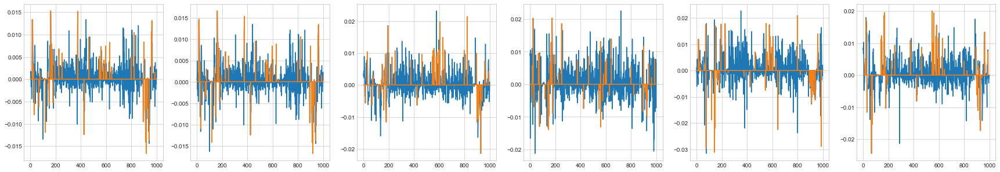

In [94]:
model_nomal2 = MultiRBFnn(nomal_target3.size(0), 50, device)
model_nomal2.train(input_, nomal_target3, 3000, 0.0001, 0.00006, 0.0001)

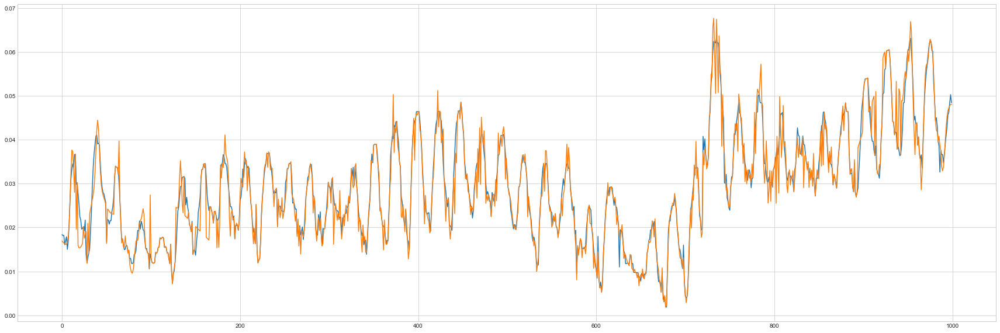

In [95]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), nomal_target3[0].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model_nomal2.pred(input_)[1][0].cpu().detach().numpy())
plt.show()

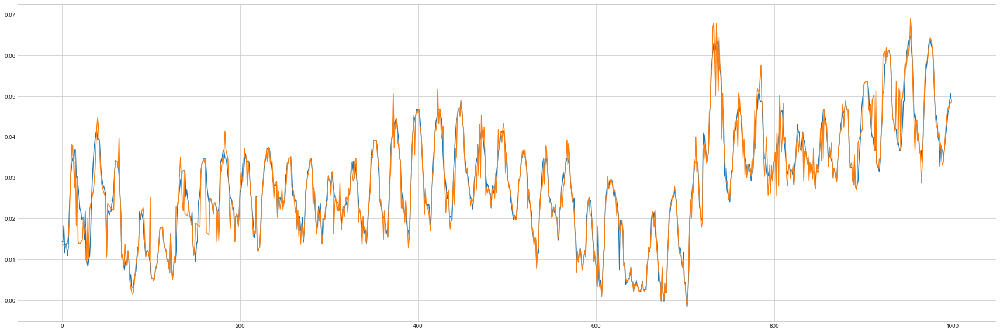

In [96]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), nomal_target3[1].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model_nomal2.pred(input_)[1][1].cpu().detach().numpy())
plt.show()

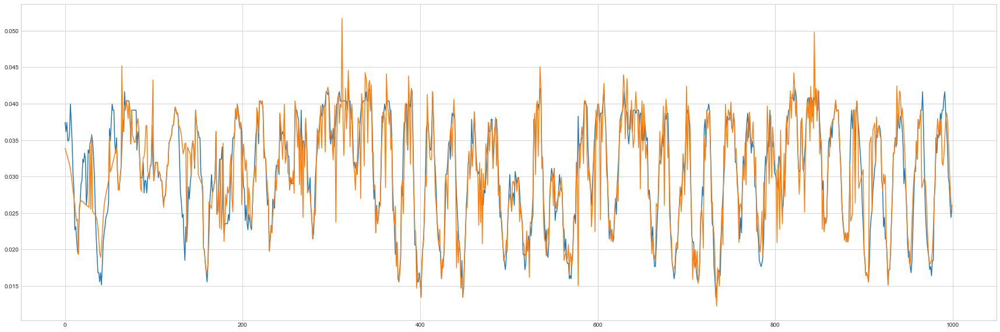

In [97]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), nomal_target3[2].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model_nomal2.pred(input_)[1][2].cpu().detach().numpy())
plt.show()

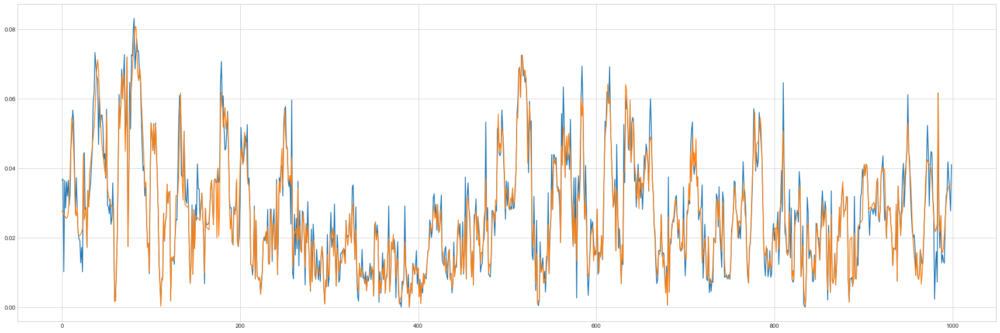

In [98]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), nomal_target3[3].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model_nomal2.pred(input_)[1][3].cpu().detach().numpy())
plt.show()

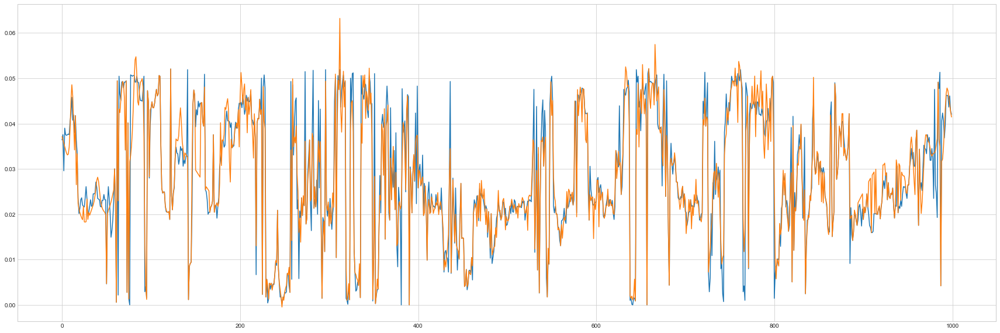

In [99]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), nomal_target3[4].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model_nomal2.pred(input_)[1][4].cpu().detach().numpy())
plt.show()

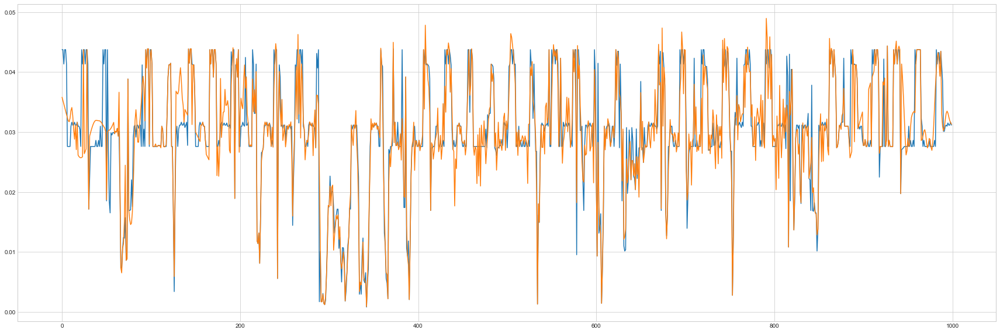

In [100]:
plt.figure(figsize=(30, 10))
plt.plot(input_.cpu().detach().numpy(), nomal_target3[5].cpu().detach().numpy())
plt.plot(input_.cpu().detach().numpy(), model_nomal2.pred(input_)[1][5].cpu().detach().numpy())
plt.show()